# Cab Companies Data Analysis and Insights

### Imports

In [2]:
%matplotlib inline
import pandas as pd
import numpy as np

from pandas_profiling import ProfileReport

import matplotlib.pyplot as plt
import seaborn as sns

from scipy import stats

C:\Users\rgs88\anaconda3\lib\site-packages\numba\core\decorators.py:262: NumbaDeprecationWarning: numba.generated_jit is deprecated. Please see the documentation at: https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-generated-jit for more information and advice on a suitable replacement.
  warnings.warn(msg, NumbaDeprecationWarning)
C:\Users\rgs88\anaconda3\lib\site-packages\visions\backends\shared\nan_handling.py:51: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  def hasna(x: np.ndarray) -> bool:


### Data Loading, Cleaning and Inspection

In [3]:
cab_data = pd.read_csv("https://raw.githubusercontent.com/DataGlacier/DataSets/main/Cab_Data.csv")
city_data = pd.read_csv("https://raw.githubusercontent.com/DataGlacier/DataSets/main/City.csv")
transaction_data = pd.read_csv("https://raw.githubusercontent.com/DataGlacier/DataSets/main/Transaction_ID.csv")
customer_data = pd.read_csv("https://raw.githubusercontent.com/DataGlacier/DataSets/main/Customer_ID.csv")

In [4]:
def data_inspection(df):
    null = df.isnull().sum()
    duplicate = df.duplicated().sum()
    percentage_null = 100*(null/len(df))
    data_type = df.dtypes
    unique = df.nunique()
    return pd.DataFrame({"Duplicated Values": duplicate,
                         "Null Values": null,
                         "Percentage of Null Values": percentage_null,
                         "Unique Values": unique,
                         "Data Type": data_type})

In [5]:
data_inspection(cab_data)

,Duplicated Values,Null Values,Percentage of Null Values,Unique Values,Data Type
Transaction ID,0,0,0.0,359392,int64
Date of Travel,0,0,0.0,1095,int64
Company,0,0,0.0,2,object
City,0,0,0.0,19,object
KM Travelled,0,0,0.0,874,float64
Price Charged,0,0,0.0,99176,float64
Cost of Trip,0,0,0.0,16291,float64


In [6]:
data_inspection(city_data)

,Duplicated Values,Null Values,Percentage of Null Values,Unique Values,Data Type
City,0,0,0.0,20,object
Population,0,0,0.0,20,object
Users,0,0,0.0,20,object


In [7]:
data_inspection(transaction_data)

,Duplicated Values,Null Values,Percentage of Null Values,Unique Values,Data Type
Transaction ID,0,0,0.0,440098,int64
Customer ID,0,0,0.0,49171,int64
Payment_Mode,0,0,0.0,2,object


In [8]:
data_inspection(customer_data)

,Duplicated Values,Null Values,Percentage of Null Values,Unique Values,Data Type
Customer ID,0,0,0.0,49171,int64
Gender,0,0,0.0,2,object
Age,0,0,0.0,48,int64
Income (USD/Month),0,0,0.0,23341,int64


In [9]:
transaction_data.columns

Index(['Transaction ID', 'Customer ID', 'Payment_Mode'], dtype='object')

In [10]:
# Master DataFrame
master_dataframe = cab_data.merge(city_data, on = "City")\
                           .merge(transaction_data, on = "Transaction ID")\
                           .merge(customer_data, on = "Customer ID")

In [11]:
pink_cab_dataframe = master_dataframe[master_dataframe["Company"] == "Pink Cab"]
yellow_cab_dataframe = master_dataframe[master_dataframe["Company"] == "Yellow Cab"]
pink_cab_dataframe

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Population,Users,Customer ID,Payment_Mode,Gender,Age,Income (USD/Month)
0,10000011,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.635,"814,885","24,701",29290,Card,Male,28,10813
3,10000012,42375,Pink Cab,ATLANTA GA,28.62,358.52,334.854,"814,885","24,701",27703,Card,Male,27,9237
6,10395626,43400,Pink Cab,ATLANTA GA,13.39,167.03,141.934,"814,885","24,701",27703,Card,Male,27,9237
7,10000013,42371,Pink Cab,ATLANTA GA,9.04,125.20,97.632,"814,885","24,701",28712,Cash,Male,53,11242
11,10000014,42376,Pink Cab,ATLANTA GA,33.17,377.40,351.602,"814,885","24,701",28020,Cash,Male,23,23327
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
359332,10200082,42939,Pink Cab,WASHINGTON DC,20.23,347.58,218.484,"418,859","127,001",52425,Cash,Male,58,10737
359346,10262863,43058,Pink Cab,WASHINGTON DC,4.44,61.95,50.616,"418,859","127,001",51257,Card,Male,39,15247
359356,10417014,43436,Pink Cab,WASHINGTON DC,40.95,565.07,434.070,"418,859","127,001",51257,Card,Male,39,15247
359358,10197277,42939,Pink Cab,WASHINGTON DC,32.64,375.27,368.832,"418,859","127,001",51510,Card,Female,18,6855


In [12]:
master_dataframe

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Population,Users,Customer ID,Payment_Mode,Gender,Age,Income (USD/Month)
0,10000011,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.6350,"814,885","24,701",29290,Card,Male,28,10813
1,10351127,43302,Yellow Cab,ATLANTA GA,26.19,598.70,317.4228,"814,885","24,701",29290,Cash,Male,28,10813
2,10412921,43427,Yellow Cab,ATLANTA GA,42.55,792.05,597.4020,"814,885","24,701",29290,Card,Male,28,10813
3,10000012,42375,Pink Cab,ATLANTA GA,28.62,358.52,334.8540,"814,885","24,701",27703,Card,Male,27,9237
4,10320494,43211,Yellow Cab,ATLANTA GA,36.38,721.10,467.1192,"814,885","24,701",27703,Card,Male,27,9237
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
359387,10307228,43162,Yellow Cab,WASHINGTON DC,38.40,668.93,525.3120,"418,859","127,001",51406,Cash,Female,29,6829
359388,10319775,43203,Yellow Cab,WASHINGTON DC,3.57,67.60,44.5536,"418,859","127,001",51406,Cash,Female,29,6829
359389,10347676,43287,Yellow Cab,WASHINGTON DC,23.46,331.97,337.8240,"418,859","127,001",51406,Card,Female,29,6829
359390,10358624,43314,Yellow Cab,WASHINGTON DC,27.60,358.23,364.3200,"418,859","127,001",51406,Cash,Female,29,6829


In [13]:
#Feature Engineering and Creation

#Date-Time Formatting
datelist = master_dataframe["Date of Travel"].to_list()
base_date = pd.Timestamp('1899-12-29')
datelist2 = [base_date + pd.DateOffset(date_offset) for date_offset in datelist]
master_dataframe["Date of Travel"] = pd.to_datetime(datelist2, format = '%d/%m/%y')

#Changing some column types to integers
master_dataframe = master_dataframe.replace(',','', regex=True)
master_dataframe[['Population', 'Users']] = master_dataframe[['Population', 'Users']].astype(str).astype(int)
master_dataframe.info()

#New Features
master_dataframe["Profit"] = master_dataframe["Price Charged"] - master_dataframe["Cost of Trip"]
master_dataframe["Price_per_KM"] = master_dataframe["Price Charged"] / master_dataframe["KM Travelled"]
master_dataframe["Cost_per_KM"] = master_dataframe["Cost of Trip"] / master_dataframe["KM Travelled"]
master_dataframe["Percentage_Population"] = (master_dataframe["Users"] / master_dataframe["Population"]) * 100
master_dataframe["Year"] = master_dataframe["Date of Travel"].dt.year
master_dataframe["Month"] = master_dataframe["Date of Travel"].dt.month
master_dataframe["Day"] = master_dataframe["Date of Travel"].dt.day
master_dataframe['Ride_Count'] = master_dataframe.groupby('Customer ID')['Transaction ID'].transform('count')

# Define the age bins and categories
age_bins = [18, 21, 25, 30, 40, 50, 60, 65]
age_categories = ["18-21", "22-25", "26-30", "31-40", "41-50", "51-60", "61-65"]

# Categorize ages into age categories
master_dataframe["Age_Category"] = pd.cut(master_dataframe["Age"], bins=age_bins, labels=age_categories, ordered=False)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 359392 entries, 0 to 359391
Data columns (total 14 columns):
 #   Column              Non-Null Count   Dtype         
---  ------              --------------   -----         
 0   Transaction ID      359392 non-null  int64         
 1   Date of Travel      359392 non-null  datetime64[ns]
 2   Company             359392 non-null  object        
 3   City                359392 non-null  object        
 4   KM Travelled        359392 non-null  float64       
 5   Price Charged       359392 non-null  float64       
 6   Cost of Trip        359392 non-null  float64       
 7   Population          359392 non-null  int32         
 8   Users               359392 non-null  int32         
 9   Customer ID         359392 non-null  int64         
 10  Payment_Mode        359392 non-null  object        
 11  Gender              359392 non-null  object        
 12  Age                 359392 non-null  int64         
 13  Income (USD/Month)  359392 no

In [14]:
master_dataframe["Month"] = master_dataframe["Month"].astype(str)
monthly_mapping = {
    "1": "Jan",
    "2": "Feb",
    "3": "Mar",
    "4": "Apr",
    "5": "May",
    "6": "Jun",
    "7": "Jul",
    "8": "Aug",
    "9": "Sep",
    "10": "Oct",
    "11": "Nov",
    "12": "Dec"
}
master_dataframe["Month_New"] = master_dataframe["Month"].map(monthly_mapping)

In [15]:
master_dataframe = master_dataframe.rename(columns = {"Income (USD/Month)": "Income"})

In [16]:
master_dataframe.rename(columns = {"City" : "City, State Abbreviation"})

,Transaction ID,Date of Travel,Company,"City, State Abbreviation",KM Travelled,Price Charged,Cost of Trip,Population,Users,Customer ID,...,Profit,Price_per_KM,Cost_per_KM,Percentage_Population,Year,Month,Day,Ride_Count,Age_Category,Month_New
0,10000011,2016-01-07,Pink Cab,ATLANTA GA,30.45,370.95,313.6350,814885,24701,29290,...,57.3150,12.182266,10.30,3.031225,2016,1,7,3,26-30,Jan
1,10351127,2018-07-20,Yellow Cab,ATLANTA GA,26.19,598.70,317.4228,814885,24701,29290,...,281.2772,22.859870,12.12,3.031225,2018,7,20,3,26-30,Jul
2,10412921,2018-11-22,Yellow Cab,ATLANTA GA,42.55,792.05,597.4020,814885,24701,29290,...,194.6480,18.614571,14.04,3.031225,2018,11,22,3,26-30,Nov
3,10000012,2016-01-05,Pink Cab,ATLANTA GA,28.62,358.52,334.8540,814885,24701,27703,...,23.6660,12.526904,11.70,3.031225,2016,1,5,4,26-30,Jan
4,10320494,2018-04-20,Yellow Cab,ATLANTA GA,36.38,721.10,467.1192,814885,24701,27703,...,253.9808,19.821330,12.84,3.031225,2018,4,20,4,26-30,Apr
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
359387,10307228,2018-03-02,Yellow Cab,WASHINGTON DC,38.40,668.93,525.3120,418859,127001,51406,...,143.6180,17.420052,13.68,30.320705,2018,3,2,6,26-30,Mar
359388,10319775,2018-04-12,Yellow Cab,WASHINGTON DC,3.57,67.60,44.5536,418859,127001,51406,...,23.0464,18.935574,12.48,30.320705,2018,4,12,6,26-30,Apr
359389,10347676,2018-07-05,Yellow Cab,WASHINGTON DC,23.46,331.97,337.8240,418859,127001,51406,...,-5.8540,14.150469,14.40,30.320705,2018,7,5,6,26-30,Jul
359390,10358624,2018-08-01,Yellow Cab,WASHINGTON DC,27.60,358.23,364.3200,418859,127001,51406,...,-6.0900,12.979348,13.20,30.320705,2018,8,1,6,26-30,Aug


In [17]:
master_dataframe.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 359392 entries, 0 to 359391
Data columns (total 24 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   Transaction ID         359392 non-null  int64         
 1   Date of Travel         359392 non-null  datetime64[ns]
 2   Company                359392 non-null  object        
 3   City                   359392 non-null  object        
 4   KM Travelled           359392 non-null  float64       
 5   Price Charged          359392 non-null  float64       
 6   Cost of Trip           359392 non-null  float64       
 7   Population             359392 non-null  int32         
 8   Users                  359392 non-null  int32         
 9   Customer ID            359392 non-null  int64         
 10  Payment_Mode           359392 non-null  object        
 11  Gender                 359392 non-null  object        
 12  Age                    359392 non-null  int6

In [18]:
master_dataframe.describe()

,Transaction ID,KM Travelled,Price Charged,Cost of Trip,Population,Users,Customer ID,Age,Income,Profit,Price_per_KM,Cost_per_KM,Percentage_Population,Year,Day,Ride_Count
count,3.593920e+05,359392.000000,359392.000000,359392.000000,3.593920e+05,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000
mean,1.022076e+07,22.567254,423.443311,286.190113,3.132198e+06,158365.582267,19191.652115,35.336705,15048.822937,137.253198,18.765127,12.681548,10.668662,2017.041693,15.641700,18.675524
std,1.268058e+05,12.233526,274.378911,157.993661,3.315194e+06,100850.051020,21012.412463,12.594234,7969.409482,160.311840,5.878560,1.167944,10.633114,0.801378,8.838986,11.832334
min,1.000001e+07,1.900000,15.600000,19.000000,2.489680e+05,3643.000000,1.000000,18.000000,2000.000000,-220.060000,6.338621,10.000000,0.649683,2016.000000,1.000000,1.000000
25%,1.011081e+07,12.000000,206.437500,151.200000,6.712380e+05,80021.000000,2705.000000,25.000000,8424.000000,28.012000,14.451327,12.000000,3.594514,2016.000000,8.000000,9.000000
50%,1.022104e+07,22.440000,386.360000,282.480000,1.595037e+06,144132.000000,7459.000000,33.000000,14685.000000,81.962000,17.153501,12.840000,7.296413,2017.000000,16.000000,17.000000
75%,1.033094e+07,32.960000,583.660000,413.683200,8.405837e+06,302149.000000,36078.000000,42.000000,21035.000000,190.030000,22.234926,13.680000,9.036279,2018.000000,23.000000,28.000000
max,1.044011e+07,48.000000,2048.030000,691.200000,8.405837e+06,302149.000000,60000.000000,65.000000,35000.000000,1463.966000,53.955556,14.400000,32.141078,2018.000000,31.000000,54.000000


#### Pandas Profiling of all Datasets

In [23]:
#Pandas profiling report of final dataframe
final_report = ProfileReport(master_dataframe)
final_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [24]:
master_dataframe.to_csv(r"C:\Users\rgs88\OneDrive\Documents\Data Glacier Internship\master_data.csv")

### Correlation of the Dataset

In [25]:
master_dataframe.corr()

,Transaction ID,KM Travelled,Price Charged,Cost of Trip,Population,Users,Customer ID,Age,Income,Profit,Price_per_KM,Cost_per_KM,Percentage_Population,Year,Day,Ride_Count
Transaction ID,1.000000,-0.001429,-0.052902,-0.003462,0.023868,0.013526,-0.016912,-0.001267,-0.001570,-0.087130,-0.106457,-0.011241,-0.022612,0.941475,0.014824,0.012798
KM Travelled,-0.001429,1.000000,0.835753,0.981848,-0.002311,-0.000428,0.000389,-0.000369,-0.000544,0.462768,-0.000474,0.000167,0.002305,-0.001094,0.000767,-0.000366
Price Charged,-0.052902,0.835753,1.000000,0.859812,0.326589,0.281061,-0.177324,-0.003084,0.003228,0.864154,0.482493,0.182424,-0.150070,-0.036903,-0.006820,0.258054
Cost of Trip,-0.003462,0.981848,0.859812,1.000000,0.015108,0.023628,0.003077,-0.000189,-0.000633,0.486056,0.062429,0.166831,0.018128,-0.001766,0.000726,0.023218
Population,0.023868,-0.002311,0.326589,0.015108,1.000000,0.915490,-0.647052,-0.009002,0.011868,0.544079,0.681364,0.104546,-0.498707,0.000061,-0.000396,0.845721
Users,0.013526,-0.000428,0.281061,0.023628,0.915490,1.000000,-0.610742,-0.005906,0.010464,0.457758,0.584375,0.144276,-0.258919,-0.000556,-0.001356,0.935302
Customer ID,-0.016912,0.000389,-0.177324,0.003077,-0.647052,-0.610742,1.000000,-0.004735,-0.013608,-0.306527,-0.368361,0.016648,0.805490,-0.002480,0.000763,-0.556163
Age,-0.001267,-0.000369,-0.003084,-0.000189,-0.009002,-0.005906,-0.004735,1.000000,0.003907,-0.005093,-0.006039,0.000112,-0.001778,-0.000497,-0.002291,-0.000739
Income,-0.001570,-0.000544,0.003228,-0.000633,0.011868,0.010464,-0.013608,0.003907,1.000000,0.006148,0.007632,-0.000309,-0.009332,-0.001679,0.000927,0.010858
Profit,-0.087130,0.462768,0.864154,0.486056,0.544079,0.457758,-0.306527,-0.005093,0.006148,1.000000,0.764276,0.147806,-0.274715,-0.061420,-0.012388,0.418786


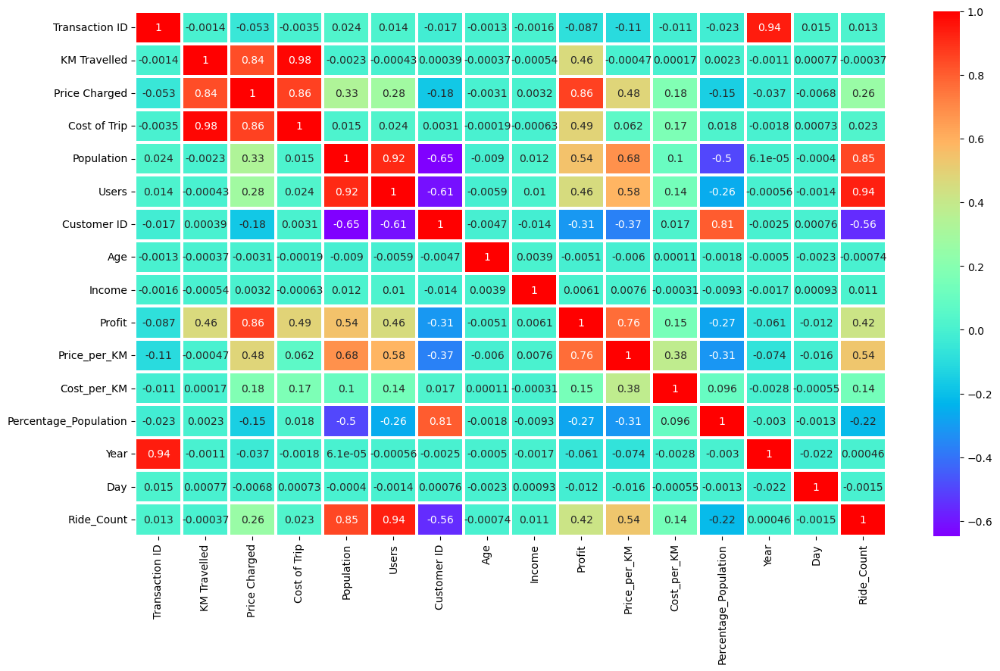

In [26]:
plt.figure(figsize = (16, 9))
ax = sns.heatmap(master_dataframe.corr(), cmap = "rainbow", annot = True, linewidth = 1.5)

In [27]:
master_dataframe.describe()

,Transaction ID,KM Travelled,Price Charged,Cost of Trip,Population,Users,Customer ID,Age,Income,Profit,Price_per_KM,Cost_per_KM,Percentage_Population,Year,Day,Ride_Count
count,3.593920e+05,359392.000000,359392.000000,359392.000000,3.593920e+05,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000
mean,1.022076e+07,22.567254,423.443311,286.190113,3.132198e+06,158365.582267,19191.652115,35.336705,15048.822937,137.253198,18.765127,12.681548,10.668662,2017.041693,15.641700,18.675524
std,1.268058e+05,12.233526,274.378911,157.993661,3.315194e+06,100850.051020,21012.412463,12.594234,7969.409482,160.311840,5.878560,1.167944,10.633114,0.801378,8.838986,11.832334
min,1.000001e+07,1.900000,15.600000,19.000000,2.489680e+05,3643.000000,1.000000,18.000000,2000.000000,-220.060000,6.338621,10.000000,0.649683,2016.000000,1.000000,1.000000
25%,1.011081e+07,12.000000,206.437500,151.200000,6.712380e+05,80021.000000,2705.000000,25.000000,8424.000000,28.012000,14.451327,12.000000,3.594514,2016.000000,8.000000,9.000000
50%,1.022104e+07,22.440000,386.360000,282.480000,1.595037e+06,144132.000000,7459.000000,33.000000,14685.000000,81.962000,17.153501,12.840000,7.296413,2017.000000,16.000000,17.000000
75%,1.033094e+07,32.960000,583.660000,413.683200,8.405837e+06,302149.000000,36078.000000,42.000000,21035.000000,190.030000,22.234926,13.680000,9.036279,2018.000000,23.000000,28.000000
max,1.044011e+07,48.000000,2048.030000,691.200000,8.405837e+06,302149.000000,60000.000000,65.000000,35000.000000,1463.966000,53.955556,14.400000,32.141078,2018.000000,31.000000,54.000000


In [28]:
numerical_variables = master_dataframe[["KM Travelled", "Price Charged", "Cost of Trip", "Income", "Profit", "Price_per_KM", "Cost_per_KM", "Ride_Count"]]
numerical_variables

,KM Travelled,Price Charged,Cost of Trip,Income,Profit,Price_per_KM,Cost_per_KM,Ride_Count
0,30.45,370.95,313.6350,10813,57.3150,12.182266,10.30,3
1,26.19,598.70,317.4228,10813,281.2772,22.859870,12.12,3
2,42.55,792.05,597.4020,10813,194.6480,18.614571,14.04,3
3,28.62,358.52,334.8540,9237,23.6660,12.526904,11.70,4
4,36.38,721.10,467.1192,9237,253.9808,19.821330,12.84,4
...,...,...,...,...,...,...,...,...
359387,38.40,668.93,525.3120,6829,143.6180,17.420052,13.68,6
359388,3.57,67.60,44.5536,6829,23.0464,18.935574,12.48,6
359389,23.46,331.97,337.8240,6829,-5.8540,14.150469,14.40,6
359390,27.60,358.23,364.3200,6829,-6.0900,12.979348,13.20,6


## EDA

### Users per Company

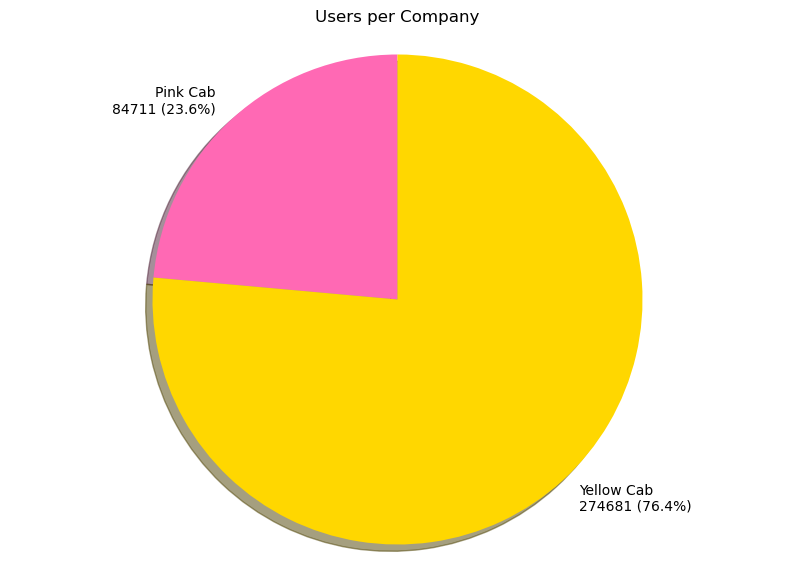

In [29]:
size_c = master_dataframe.groupby(["Company"])["Customer ID"].count()
sizes = size_c.values.tolist()
companies = size_c.index.tolist()

figp, axp = plt.subplots(figsize=(10, 7))

custom_colors = ["hotpink", "gold"]
percentages = [f"{size / sum(sizes) * 100:.1f}%" for size in sizes]

labels = [f"{company}\n{size} ({percentage})" for company, size, percentage in zip(companies, sizes, percentages)]

axp.pie(sizes, labels=labels, shadow=True, startangle=90, autopct="", colors = custom_colors)

axp.axis("equal")
plt.title("Users per Company")
plt.show()

Insights:
- Yellow Cab have more than three times as many customers.
- In traditional machine learning model training, we would upsample the pink cab data to avoid bias.

### Profit per Company

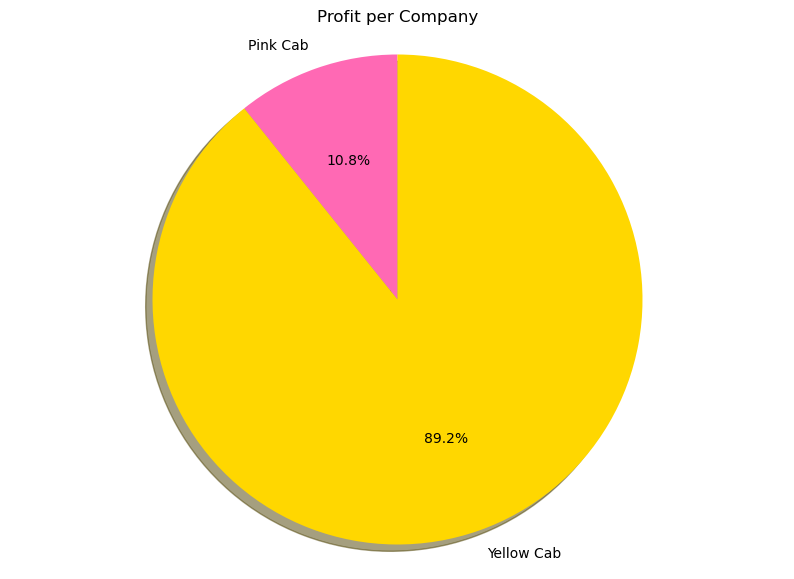

In [30]:
profit_c = master_dataframe.groupby(["Company"])["Profit"].sum()
profits = profit_c.values.tolist()

custom_colors = ["hotpink", "gold"]
figp1, axp1 = plt.subplots(figsize = (10,7))
axp1.pie(profits, labels = companies, autopct= '%1.1f%%', shadow = True, startangle = 90, colors = custom_colors)
axp1.axis("equal")

plt.title("Profit per Company")
plt.show()

Insights: 
- Yellow Cab make even more profits than Pink Cab with almost 9 times as much.
- From this alone, we can say Yellow Cab is a better investment for Company XYZ.

### Yearly Analysis

In [31]:
year_analysis = master_dataframe.groupby(["Year", "Company"]).agg({"Profit": "sum", "Customer ID": "nunique", "Price_per_KM": "mean", "Cost_per_KM": "mean", "Transaction ID": "count"}).reset_index()
year_analysis["Gap_PC"] = year_analysis["Price_per_KM"] - year_analysis["Cost_per_KM"]
year_analysis

,Year,Company,Profit,Customer ID,Price_per_KM,Cost_per_KM,Transaction ID,Gap_PC
0,2016,Pink Cab,1.739883e+06,16751,14.038441,10.992458,25285,3.045984
1,2016,Yellow Cab,1.407389e+07,26043,20.706754,13.200793,82937,7.505961
2,2017,Pink Cab,2.015101e+06,18582,13.947693,10.998805,30205,2.948888
3,2017,Yellow Cab,1.646427e+07,27749,20.680159,13.203673,97759,7.476486
4,2018,Pink Cab,1.552345e+06,18361,13.349721,11.003710,29221,2.346011
5,2018,Yellow Cab,1.348222e+07,27424,19.563384,13.197131,93985,6.366253


Insights:
- 2017 was the best year for both companies in terms of profit and the number of customers.
- It costs more for yellow cab than it does for pink cab to travel, they have a higher cost per KM. Perhaps this is due to better quality of transport. They could also pay their drivers more to increase employee satisfaction.
- The gap between the price per KM and the cost per KM for Yellow Cab is larger than for Pink Cab, leading to higher profits.This gap is reducing for both companies, however Yellow Cab experience a faster rate of change reducing of the Gap between the cost per KM and price per KM, which may be alarming in the future if this continues.

In [32]:
year_analysis['Profit Change (%)'] = year_analysis.groupby('Company')['Profit'].pct_change() * 100
year_analysis['Customer ID Change (%)'] = year_analysis.groupby('Company')['Customer ID'].pct_change() * 100
year_analysis['Price per KM Change (%)'] = year_analysis.groupby('Company')['Price_per_KM'].pct_change() * 100
year_analysis['Cost per KM Change (%)'] = year_analysis.groupby('Company')['Cost_per_KM'].pct_change() * 100
year_analysis['Transaction ID Change (%)'] = year_analysis.groupby('Company')['Transaction ID'].pct_change() * 100
year_analysis['GAP Change (%)'] = year_analysis.groupby('Company')['Gap_PC'].pct_change() * 100

In [33]:
master_dataframe.columns

Index(['Transaction ID', 'Date of Travel', 'Company', 'City', 'KM Travelled',
       'Price Charged', 'Cost of Trip', 'Population', 'Users', 'Customer ID',
       'Payment_Mode', 'Gender', 'Age', 'Income', 'Profit', 'Price_per_KM',
       'Cost_per_KM', 'Percentage_Population', 'Year', 'Month', 'Day',
       'Ride_Count', 'Age_Category', 'Month_New'],
      dtype='object')

### Analysing Customer ID Change Yearly

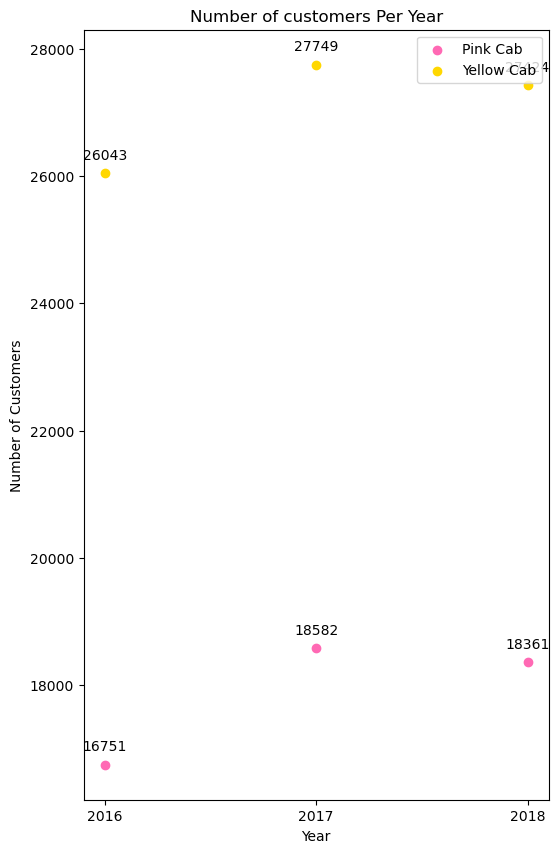

In [34]:
pivot_df1 = year_analysis.pivot(index='Year', columns='Company', values='Customer ID')
plt.figure(figsize = (6, 10))

custom_colors = {'Yellow Cab': 'gold', 'Pink Cab': 'hotpink'}

for company in pivot_df1.columns:
    plt.scatter(pivot_df1.index, pivot_df1[company], marker='o', label=company, color=custom_colors.get(company))



plt.xticks([2016, 2017, 2018])
plt.xlabel('Year')
plt.ylabel('Number of Customers')
plt.title('Number of customers Per Year')
plt.legend()

for company in pivot_df1.columns:
    for i, value in enumerate(pivot_df1[company]):
        plt.annotate(value, (pivot_df1.index[i], value), textcoords="offset points", xytext=(0,10), ha='center')

plt.show()

Insights: 
- Yellow Cab lost more customers and a larger percentage of customers from 2017 to 2018.
- Yellow Cab and Pink Cab both experienced a sharp increase in customers from 2016 to 2017.

In [35]:
pivot_df2 = year_analysis.pivot(index='Year', columns='Company', values='Customer ID Change (%)')
pivot_df2

Company,Pink Cab,Yellow Cab
Year,,
2016,NaN,NaN
2017,10.930691,6.550705
2018,-1.189323,-1.171213


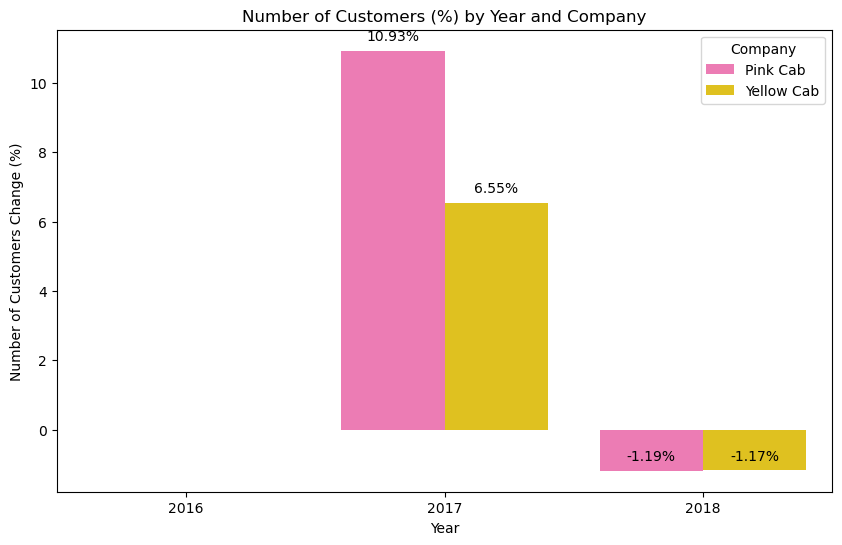

In [36]:
plt.figure(figsize=(10, 6))
custom_colors = {'Yellow Cab': 'gold', 'Pink Cab': 'hotpink'}

sns.set_palette([custom_colors.get(company) for company in year_analysis['Company']])
ax =sns.barplot(x="Year", y="Customer ID Change (%)", hue="Company", data=year_analysis)
plt.title('Number of Customers (%) by Year and Company')
plt.xlabel('Year')
plt.ylabel('Number of Customers Change (%)')

for p in ax.patches:
    if not pd.isna(p.get_height()):
        ax.annotate(f"{p.get_height():.2f}%", (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', fontsize=10, color='black', xytext=(0, 10),
                    textcoords='offset points')

plt.show()

### Analysing Number of Rides Change Yearly

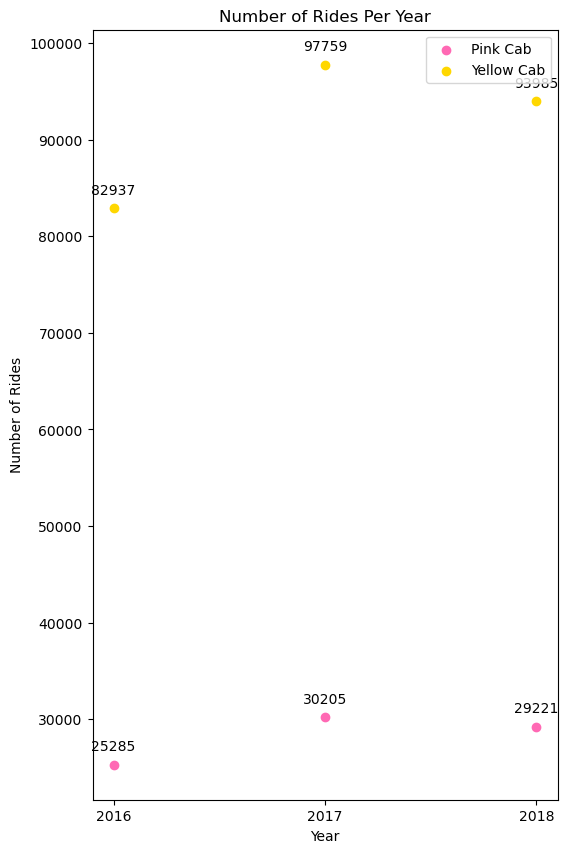

In [37]:
pivot_df1 = year_analysis.pivot(index='Year', columns='Company', values='Transaction ID')
plt.figure(figsize = (6, 10))

custom_colors = {'Yellow Cab': 'gold', 'Pink Cab': 'hotpink'}

for company in pivot_df1.columns:
    plt.scatter(pivot_df1.index, pivot_df1[company], marker='o', label=company, color=custom_colors.get(company))



plt.xticks([2016, 2017, 2018])
plt.xlabel('Year')
plt.ylabel('Number of Rides')
plt.title('Number of Rides Per Year')
plt.legend()

for company in pivot_df1.columns:
    for i, value in enumerate(pivot_df1[company]):
        plt.annotate(value, (pivot_df1.index[i], value), textcoords="offset points", xytext=(0,10), ha='center')

plt.show()

In [38]:
pivot_df2 = year_analysis.pivot(index='Year', columns='Company', values='Transaction ID Change (%)')
pivot_df2

Company,Pink Cab,Yellow Cab
Year,,
2016,NaN,NaN
2017,19.458177,17.871396
2018,-3.257739,-3.860514


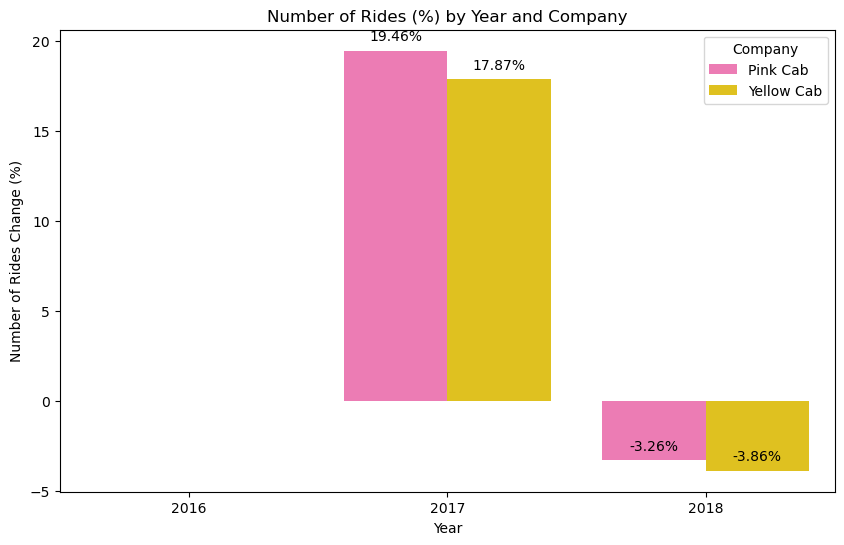

In [39]:
plt.figure(figsize=(10, 6))
custom_colors = {'Yellow Cab': 'gold', 'Pink Cab': 'hotpink'}

sns.set_palette([custom_colors.get(company) for company in year_analysis['Company']])
ax =sns.barplot(x="Year", y="Transaction ID Change (%)", hue="Company", data=year_analysis)
plt.title('Number of Rides (%) by Year and Company')
plt.xlabel('Year')
plt.ylabel('Number of Rides Change (%)')

for p in ax.patches:
    if not pd.isna(p.get_height()):
        ax.annotate(f"{p.get_height():.2f}%", (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', fontsize=10, color='black', xytext=(0, 10),
                    textcoords='offset points')

plt.show()

Insights: 
- Yellow Cab had lost a higher percentage of customers in 2018 and gained a smaller percentage of customers in 2017 compared to Pink Cab.
- A more stable investment would be Pink Cab, as the changes are less volatile every year.

### Analysing Profit Change Yearly

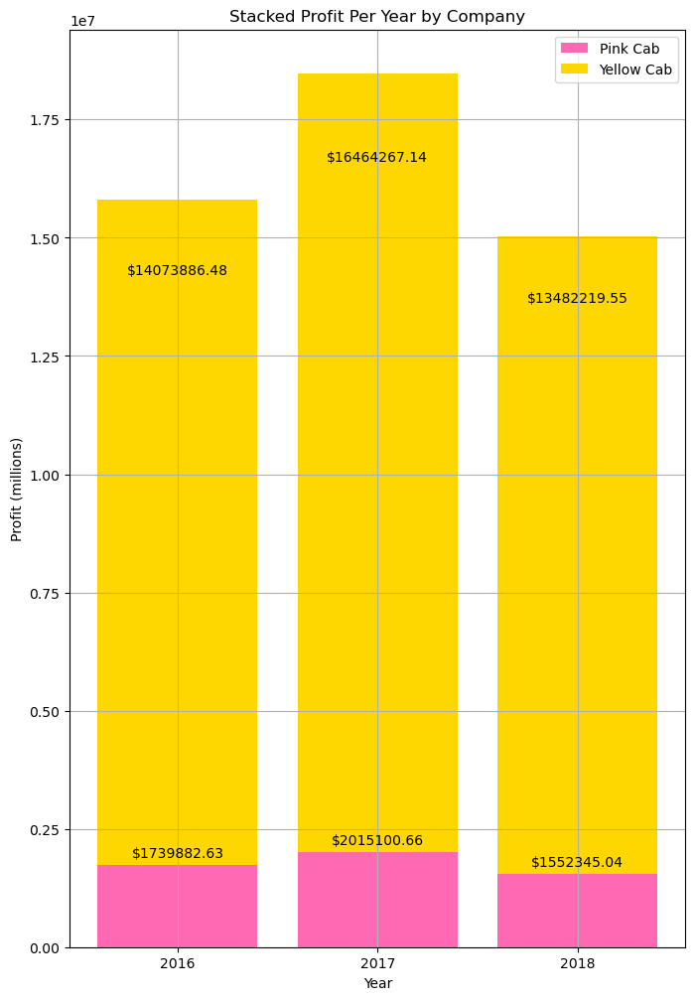

In [40]:
pivot_df3 = year_analysis.pivot(index='Year', columns='Company', values='Profit')

plt.figure(figsize=(8, 12))
bottom = None  

custom_colors = {'Yellow Cab': 'gold', 'Pink Cab': 'hotpink'}

for company in pivot_df3.columns:
    bars = plt.bar(pivot_df3.index, pivot_df3[company], label=company, bottom=bottom, color=custom_colors.get(company))
    if bottom is None:
        bottom = pivot_df3[company]
    else:
        bottom += pivot_df3[company]
    
    for bar in bars:
        height = bar.get_height()
        plt.annotate(f"${height:.2f}", xy=(bar.get_x() + bar.get_width() / 2, height),
                     xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')
        

plt.xticks([2016, 2017, 2018])

plt.xlabel('Year')
plt.ylabel('Profit (millions)')
plt.title('Stacked Profit Per Year by Company')
plt.legend()

plt.grid(True)
plt.show()

In [41]:
pivot_df4 = year_analysis.pivot(index = "Year", columns = "Company", values = 'Profit Change (%)' )
pivot_df4

Company,Pink Cab,Yellow Cab
Year,,
2016,NaN,NaN
2017,15.818195,16.98451
2018,-22.964392,-18.11224


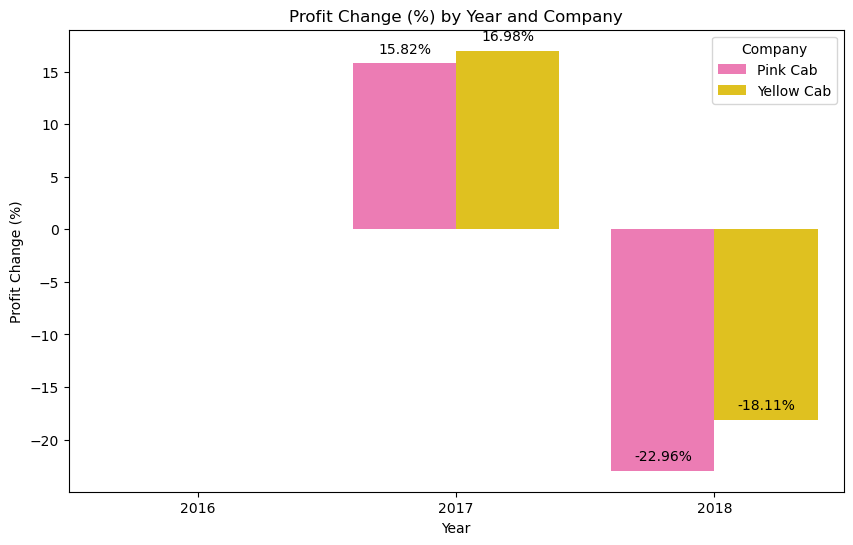

In [42]:
plt.figure(figsize=(10, 6))
ax =sns.barplot(x="Year", y="Profit Change (%)", hue="Company", data=year_analysis)
plt.title('Profit Change (%) by Year and Company')
plt.xlabel('Year')
plt.ylabel('Profit Change (%)')

custom_colors = {'Yellow Cab': 'gold', 'Pink Cab': 'hotpink'}

sns.set_palette([custom_colors.get(company) for company in year_analysis['Company']])
for p in ax.patches:
    if not pd.isna(p.get_height()):
        ax.annotate(f"{p.get_height():.2f}%", (p.get_x() + p.get_width() / 2., p.get_height()),
                    ha='center', va='center', fontsize=10, color='black', xytext=(0, 10),
                    textcoords='offset points')

plt.show()

Insights: 
- Pink Cab displayed a smaller percentage increase in profits compared to Yellow Cab in 2017.
- Yellow Cab displayed a smaller percentage decrease in profits compared to Pink Cab in 2018.
- We can conclude that profits, which is a KPI in this decision favours the Yellow Cab.

## Analysing Customer Retention

In [43]:
over_5_company = master_dataframe[master_dataframe["Ride_Count"] >= 5]

In [44]:
customer_retention = master_dataframe.groupby(["Company", "Ride_Count"]).agg({"Customer ID": "count"}).reset_index()
customer_retention

,Company,Ride_Count,Customer ID
0,Pink Cab,1,4653
1,Pink Cab,2,5890
2,Pink Cab,3,5208
3,Pink Cab,4,3883
4,Pink Cab,5,2998
...,...,...,...
101,Yellow Cab,49,220
102,Yellow Cab,50,301
103,Yellow Cab,51,89
104,Yellow Cab,53,41


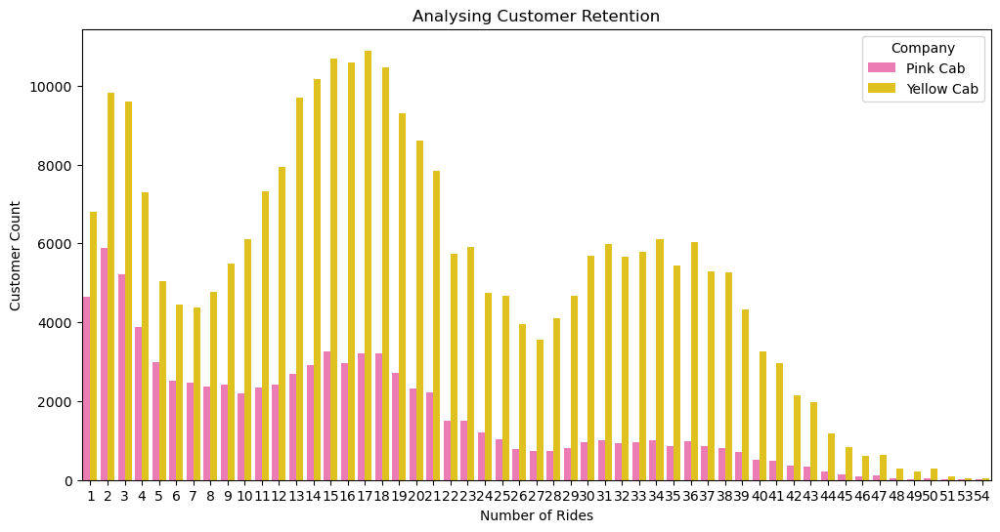

In [45]:
plt.figure(figsize=(12, 6))
sns.barplot(data=customer_retention, x="Ride_Count", y="Customer ID", hue="Company")
plt.xlabel("Number of Rides")
plt.ylabel("Customer Count")
plt.title("Analysing Customer Retention")

plt.show()

In [46]:
pink_cab_retention = pink_cab_dataframe.groupby("Customer ID")["Transaction ID"].count().reset_index()
yellow_cab_retention = yellow_cab_dataframe.groupby("Customer ID")["Transaction ID"].count().reset_index()
yellow_cab_retention

,Customer ID,Transaction ID
0,1,25
1,2,36
2,3,40
3,4,25
4,5,23
...,...,...
39891,59996,4
39892,59997,8
39893,59998,6
39894,59999,6


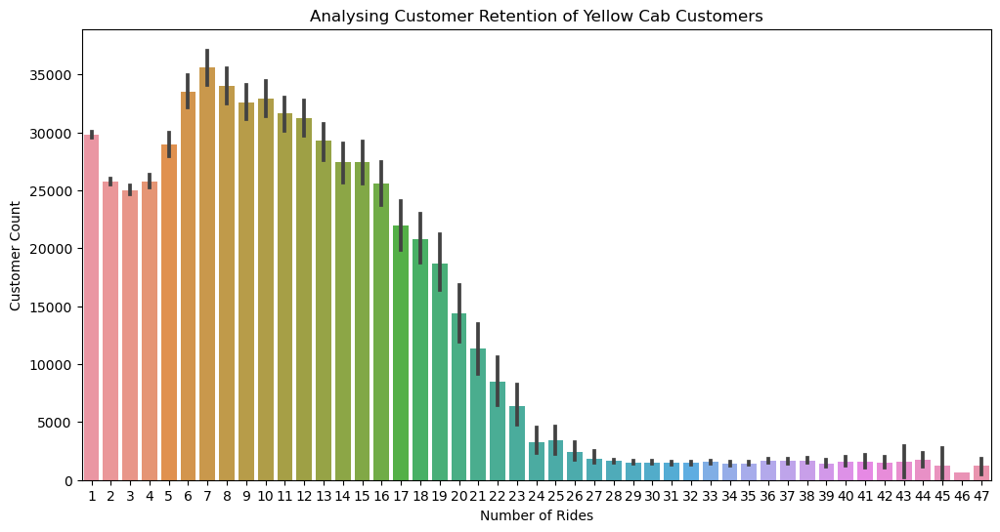

In [47]:
plt.figure(figsize=(12, 6))
sns.barplot(data=yellow_cab_retention, x="Transaction ID", y="Customer ID")
plt.xlabel("Number of Rides")
plt.ylabel("Customer Count")
plt.title("Analysing Customer Retention of Yellow Cab Customers")

plt.show()

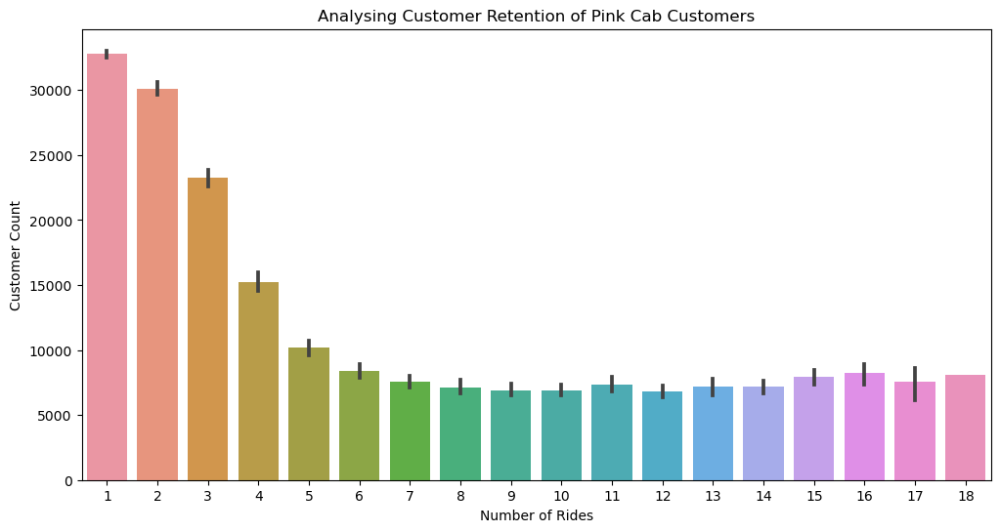

In [48]:
plt.figure(figsize=(12, 6))

sns.barplot(data=pink_cab_retention, x="Transaction ID", y="Customer ID")
plt.xlabel("Number of Rides")
plt.ylabel("Customer Count")
plt.title("Analysing Customer Retention of Pink Cab Customers")

plt.show()

In [49]:
def extract_yellow_cab(customers):
    return 'Yellow Cab' in customers

def extract_pink_cab(customers):
    return 'Pink Cab' in customers

customer_retention['Yellow Cab Customers'] = customer_retention['Company'].apply(extract_yellow_cab)
customer_retention['Pink Cab Customers'] = customer_retention['Company'].apply(extract_pink_cab)
customer_retention.drop(columns='Company', inplace=True)

print(customer_retention)

     Ride_Count  Customer ID  Yellow Cab Customers  Pink Cab Customers
0             1         4653                 False                True
1             2         5890                 False                True
2             3         5208                 False                True
3             4         3883                 False                True
4             5         2998                 False                True
..          ...          ...                   ...                 ...
101          49          220                  True               False
102          50          301                  True               False
103          51           89                  True               False
104          53           41                  True               False
105          54           47                  True               False

[106 rows x 4 columns]


### Analysing Cost Change Yearly

In [50]:
year_analysis.columns

Index(['Year', 'Company', 'Profit', 'Customer ID', 'Price_per_KM',
       'Cost_per_KM', 'Transaction ID', 'Gap_PC', 'Profit Change (%)',
       'Customer ID Change (%)', 'Price per KM Change (%)',
       'Cost per KM Change (%)', 'Transaction ID Change (%)',
       'GAP Change (%)'],
      dtype='object')

In [51]:
pivot_df5 = year_analysis.pivot(index = "Year", columns = "Company", values = "Cost_per_KM")
pivot_df5

Company,Pink Cab,Yellow Cab
Year,,
2016,10.992458,13.200793
2017,10.998805,13.203673
2018,11.003710,13.197131


Insights:
- We can see that costs per KM have been relatively stable for both companies.

In [52]:
pivot_df6 = year_analysis.pivot(index = "Year", columns = "Company", values = "Price_per_KM")
pivot_df6

Company,Pink Cab,Yellow Cab
Year,,
2016,14.038441,20.706754
2017,13.947693,20.680159
2018,13.349721,19.563384


Insights:
- Both companies are charging lower prices per KM, with their being sharper decreases in 2017 to 2018 for yellow and pink cab companies.

### Analysing Price Change Yearly

In [53]:
monthly_analysis = master_dataframe.groupby(["Year","Company", "Month", "Month_New"]).agg({"Profit": "sum", "Customer ID": "count", "Price_per_KM": "mean", "Cost_per_KM": "mean"}).reset_index()
monthly_analysis.head(30)

,Year,Company,Month,Month_New,Profit,Customer ID,Price_per_KM,Cost_per_KM
0,2016,Pink Cab,1,Jan,7.420617e+04,940,14.414752,10.997660
1,2016,Pink Cab,10,Oct,2.299183e+05,3200,14.253023,10.986250
2,2016,Pink Cab,11,Nov,2.900882e+05,3271,14.896351,10.987099
3,2016,Pink Cab,12,Dec,3.591969e+05,3630,15.346939,11.018182
4,2016,Pink Cab,2,Feb,8.838429e+04,1054,14.724258,10.973435
5,2016,Pink Cab,3,Mar,8.828073e+04,1244,14.078086,10.990032
6,2016,Pink Cab,4,Apr,8.605829e+04,1292,14.040382,10.977245
7,2016,Pink Cab,5,May,5.760784e+04,1519,12.644302,10.974984
8,2016,Pink Cab,6,Jun,7.259597e+04,1749,12.823393,10.994054
9,2016,Pink Cab,7,Jul,1.052196e+05,2116,13.141828,10.989225


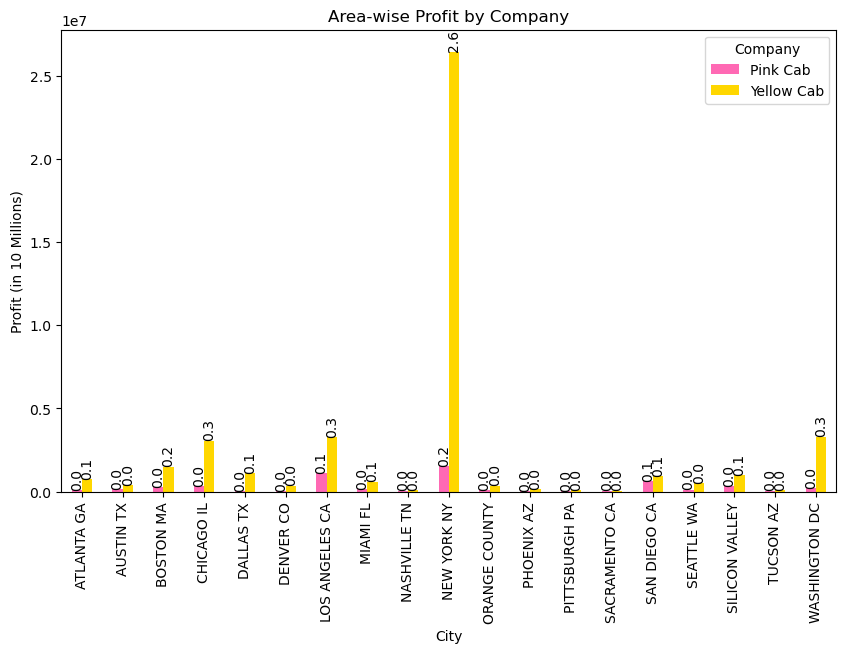

In [54]:
grouped_area = master_dataframe.groupby(["City", "Company"])["Profit"].sum().unstack()

custom_colors = ["hotpink", "gold"]
ax = grouped_area.plot(kind='bar', figsize=(10, 6), color = custom_colors)

plt.xlabel('City')
plt.ylabel('Profit (in 10 Millions)')
plt.title('Area-wise Profit by Company')

for i, bar in enumerate(ax.patches):
    height = bar.get_height()
    ax.text(
        bar.get_x() + bar.get_width() / 2,
        height + 5,  
        f'{height / 10000000:.1f}', 
        ha='center',
        va='bottom',
        rotation=90,  
        fontsize=10,  
        color='black' 
    )

plt.legend(title='Company')

plt.show()

In [55]:
grouped_area1 = master_dataframe.groupby(["City", "Company"])["Profit"].sum().unstack().reset_index()

In [56]:
grouped_area1

Company,City,Pink Cab,Yellow Cab
0,ATLANTA GA,96050.076,7.463828e+05
1,AUSTIN TX,147445.290,3.792557e+05
2,BOSTON MA,262001.698,1.506718e+06
3,CHICAGO IL,318722.488,3.068591e+06
4,DALLAS TX,24730.112,1.104003e+06
5,DENVER CO,40584.939,3.570001e+05
6,LOS ANGELES CA,1125732.065,3.285977e+06
7,MIAMI FL,162301.191,5.960001e+05
8,NASHVILLE TN,64284.534,8.524768e+04
9,NEW YORK NY,1511474.388,2.645108e+07


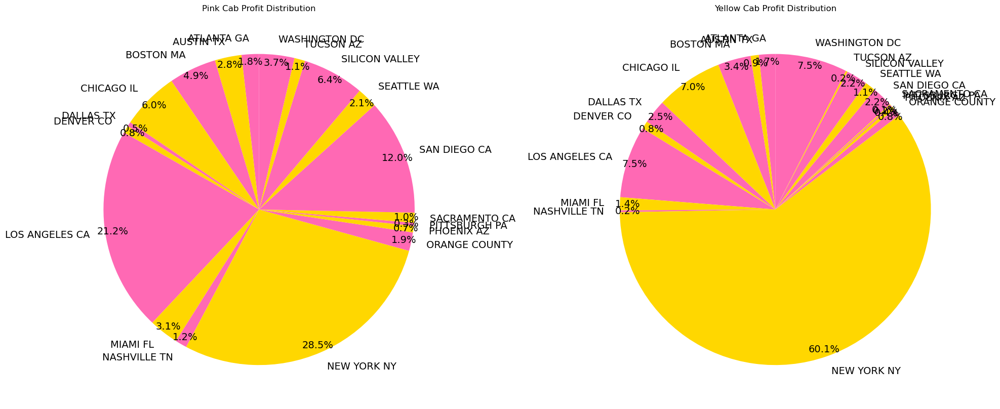

In [57]:
fig, axes = plt.subplots(1, 2, figsize=(20, 10))

def format_label(pct):
    return '{:.1f}%'.format(pct)

pink_cab_pie = axes[0].pie(grouped_area1["Pink Cab"], labels=grouped_area1["City"], startangle=90, autopct= format_label, textprops = {"fontsize": 14}, pctdistance = 0.95)
axes[0].set_title('Pink Cab Profit Distribution')

yellow_cab_pie = axes[1].pie(grouped_area1["Yellow Cab"], labels=grouped_area1["City"], startangle=90, autopct= format_label, textprops = {"fontsize": 14}, pctdistance = 0.95)
axes[1].set_title('Yellow Cab Profit Distribution')

for pie in (pink_cab_pie, yellow_cab_pie):
    for label in pie[1]:
        label.set_fontsize(14)

plt.tight_layout()
plt.show()

Insights:
- Both cab companies peak in New York, where the amount of Profit is the highest. In every earea, yellow cab outperforms pink cab in terms of profit.
- Most popular areas include New York, Los Angeles, Washington DC, Chicago and Bostom MA.

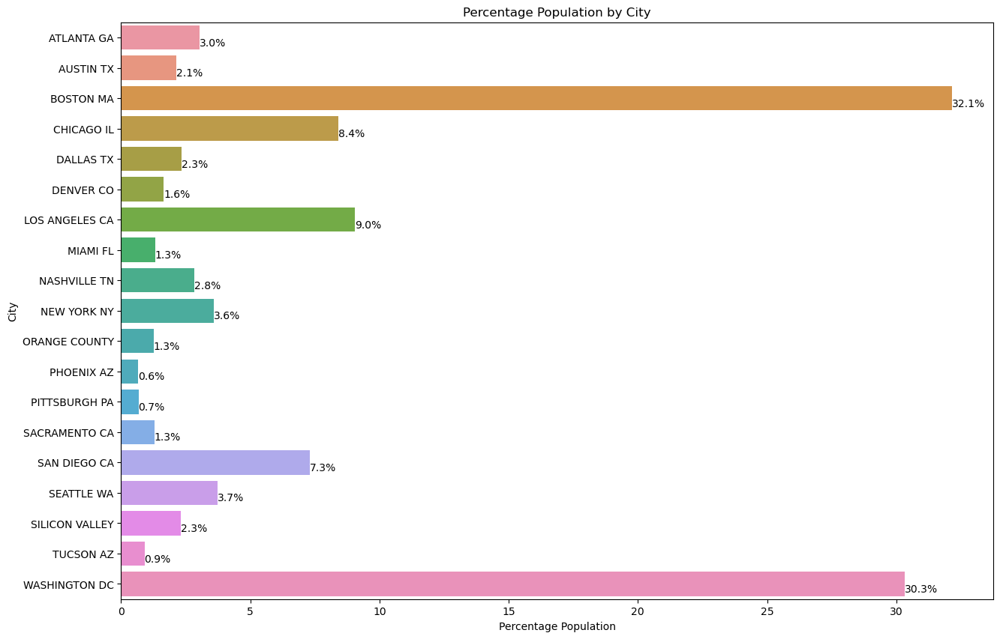

In [58]:
grouped_pop = master_dataframe.groupby(["City"])["Percentage_Population"].unique().reset_index()

grouped_pop_df = pd.DataFrame(grouped_pop, columns=["City", "Percentage_Population"])
grouped_pop_df["Percentage_Population"] = grouped_pop_df["Percentage_Population"].astype(float)

plt.figure(figsize=(15, 10))
sns.barplot(x= "Percentage_Population", y="City", data=grouped_pop_df, orient="h")
plt.xlabel('Percentage Population')
plt.ylabel('City')
plt.title('Percentage Population by City')

for index, row in grouped_pop_df.iterrows():
    plt.text(row["Percentage_Population"], index, f'{row["Percentage_Population"]:.1f}%', va='top')

plt.show()

Insights:
- Insufficient data is featured to compare cab companies here in terms of percentage population.
- However, in terms of overall users Washington DC and Boston are the cities with over 30% the whole population are using either Pink or Yellow Cab services.
- We should expand our business in New York which is drawing in the most profits per the smaller percentage population.
- Other areas to focus on are Arizona cities, Pittsburgh, Texas and Denver Colorado.

### Customer Gender x Company x Profit

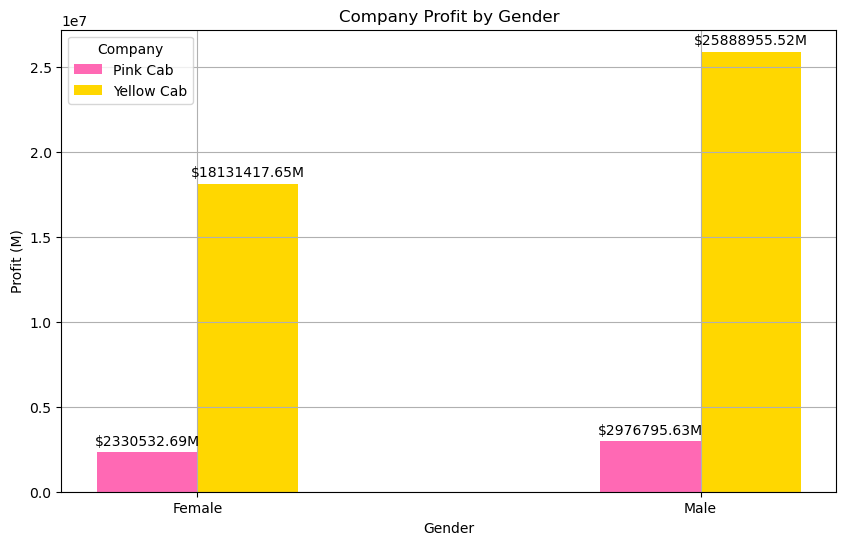

In [59]:
gender_profit = master_dataframe.groupby(["Gender", "Company"])["Profit"].sum().reset_index()
company_profit_dict = gender_profit.pivot(index='Company', columns='Gender', values='Profit').to_dict()

genders = gender_profit["Gender"].unique().tolist()
companies = gender_profit["Company"].unique().tolist()

x = np.arange(len(genders))
width = 0.2 

fig, ax = plt.subplots(figsize=(10, 6))

for i, company in enumerate(companies):
    company_profit = [company_profit_dict['Female'][company], company_profit_dict['Male'][company]]
    bars = ax.bar(x + i * width, company_profit, width, label=company)
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f"${height:.2f}M", xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

ax.set_xlabel('Gender')
ax.set_ylabel('Profit (M)')
ax.set_title('Company Profit by Gender')
ax.set_xticks(x + width * (len(companies) - 1) / 2, genders)
ax.legend(title='Company')

plt.grid(True)
plt.show()

Insights:
- Males generate more profits for companies than females, however this is due to the fact there are more male than female customers.
- The Gender ratio between both customers is more drast in the Yellow Cab company than the Pink Cab company for profits.

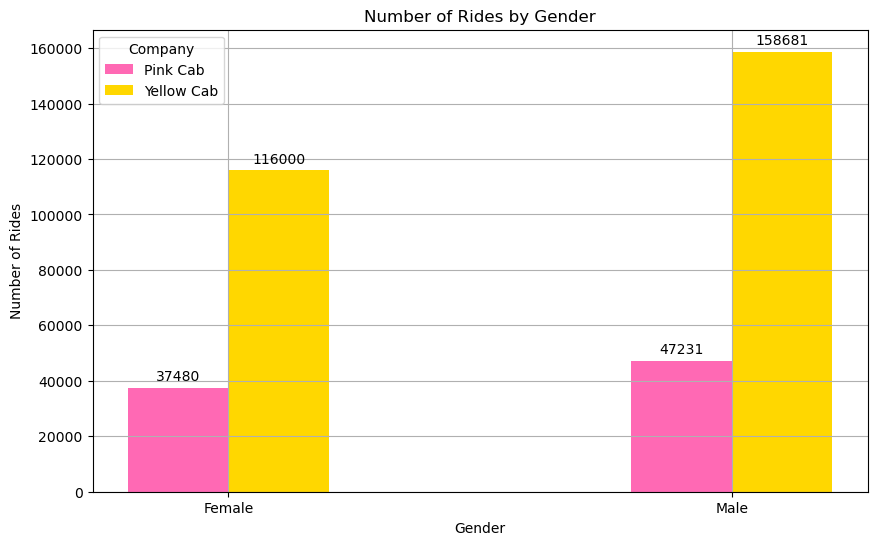

In [60]:
gender_transactions = master_dataframe.groupby(["Gender", "Company"])["Transaction ID"].count().reset_index()
company_transactions_dict = gender_transactions.pivot(index='Company', columns='Gender', values='Transaction ID').to_dict()
genders = gender_transactions["Gender"].unique().tolist()
companies = gender_transactions["Company"].unique().tolist()

x = np.arange(len(genders))
width = 0.2 

fig, ax = plt.subplots(figsize=(10, 6))

for i, company in enumerate(companies):
    company_transactions = [company_transactions_dict['Female'][company], company_transactions_dict['Male'][company]]
    bars = ax.bar(x + i * width, company_transactions, width, label=company)
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f"{height}", xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

ax.set_xlabel('Gender')
ax.set_ylabel('Number of Rides')
ax.set_title('Number of Rides by Gender')
ax.set_xticks(x + width * (len(companies) - 1) / 2, genders)
ax.legend(title='Company')

plt.grid(True)
plt.show()

In [61]:
x = master_dataframe[["Customer ID", "Transaction ID"]]
x

,Customer ID,Transaction ID
0,29290,10000011
1,29290,10351127
2,29290,10412921
3,27703,10000012
4,27703,10320494
...,...,...
359387,51406,10307228
359388,51406,10319775
359389,51406,10347676
359390,51406,10358624


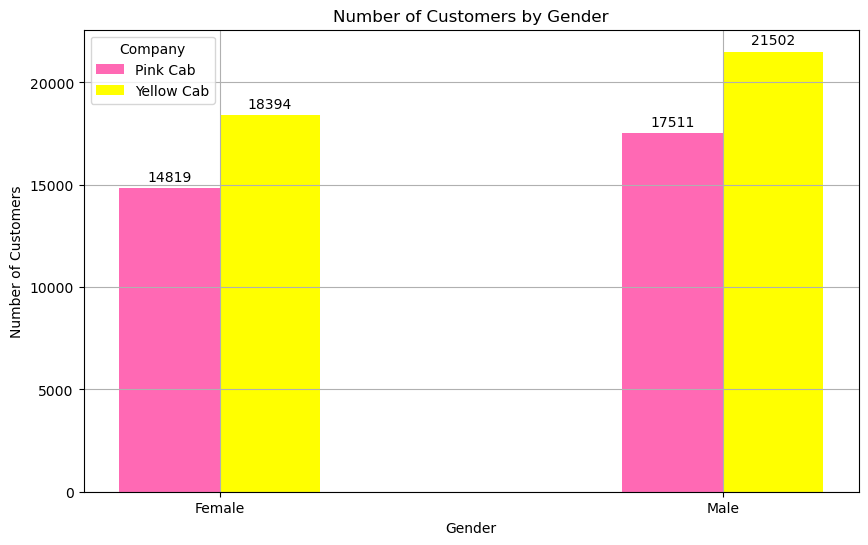

In [62]:
gender_customers = master_dataframe.groupby(["Gender", "Company"])["Customer ID"].nunique().reset_index()
company_customers_dict = gender_customers.pivot(index='Company', columns='Gender', values='Customer ID').to_dict()
genders = gender_customers["Gender"].unique().tolist()
companies = gender_customers["Company"].unique().tolist()

x = np.arange(len(genders))
width = 0.2

custom_colors = {"Pink Cab": "hotpink", "Yellow Cab": "yellow"}

fig, ax = plt.subplots(figsize=(10, 6))

for i, company in enumerate(companies):
    company_customers = [company_customers_dict['Female'][company], company_customers_dict['Male'][company]]
    bars = ax.bar(x + i * width, company_customers, width, label=company, color = custom_colors.get(company, "gray"))
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f"{height}", xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

ax.set_xlabel('Gender')
ax.set_ylabel('Number of Customers')
ax.set_title('Number of Customers by Gender')
ax.set_xticks(x + width * (len(companies) - 1) / 2, genders)
ax.legend(title='Company')

plt.grid(True)
plt.show()

Insights: 

### Customer Age x Company x Profit

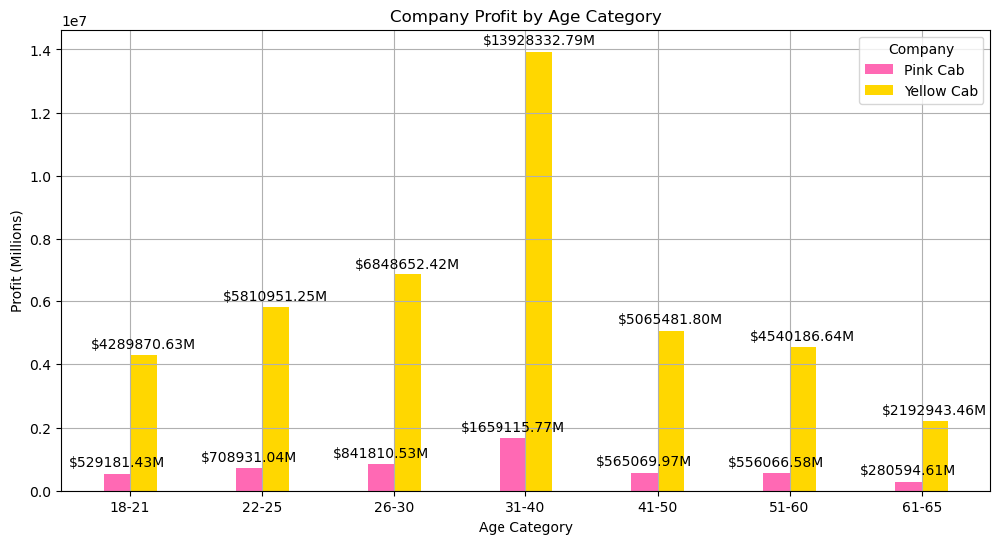

In [63]:
age_profit = master_dataframe.groupby(["Age_Category", "Company"])["Profit"].sum().reset_index()
company_profit_dict = age_profit.pivot(index='Age_Category', columns='Company', values='Profit').to_dict()
age_categories = age_profit["Age_Category"].unique().tolist()
companies = age_profit["Company"].unique().tolist()

x = np.arange(len(age_categories))
width = 0.2
custom_colors = ['hotpink', 'gold']
fig, ax = plt.subplots(figsize=(12, 6))

for i, company in enumerate(companies):
    company_profit = [company_profit_dict[company][age_category] for age_category in age_categories]
    bars = ax.bar(x + i * width, company_profit, width, label=company, color = custom_colors[i])
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f"${height:.2f}M", xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

ax.set_xlabel('Age Category')
ax.set_ylabel('Profit (Millions)')
ax.set_title('Company Profit by Age Category')
ax.set_xticks(x + width * (len(companies) - 1) / 2, age_categories)
ax.legend(title='Company')

plt.grid(True)
plt.show()

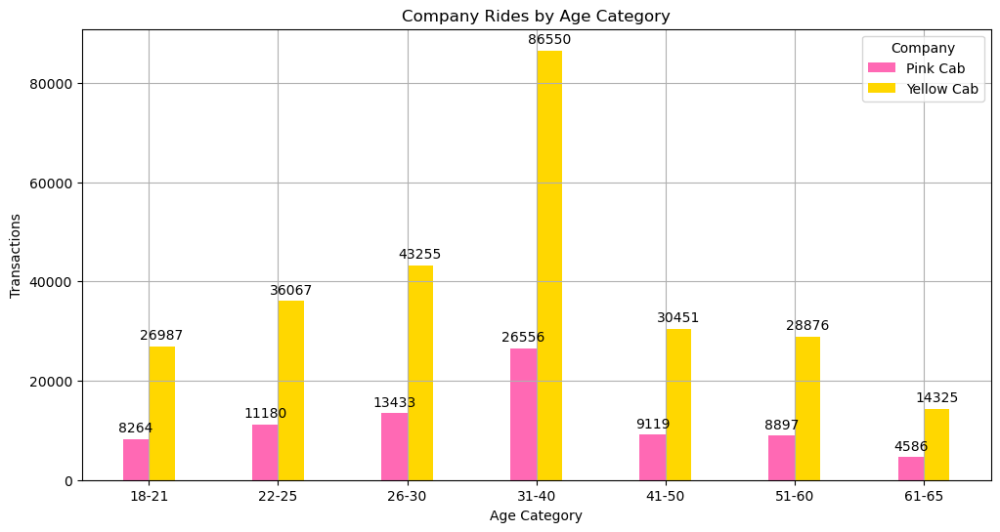

In [64]:
age_transactions = master_dataframe.groupby(["Age_Category", "Company"])["Transaction ID"].count().reset_index()
company_transactions_dict = age_transactions.pivot(index='Age_Category', columns='Company', values='Transaction ID').to_dict()
age_categories = age_transactions["Age_Category"].unique().tolist()
companies = age_transactions["Company"].unique().tolist()

x = np.arange(len(age_categories))
width = 0.2
custom_colors = ['hotpink', 'gold']

fig, ax = plt.subplots(figsize=(12, 6))

for i, company in enumerate(companies):
    company_transactions = [company_transactions_dict[company][age_category] for age_category in age_categories]
    bars = ax.bar(x + i * width, company_transactions, width, label=company, color = custom_colors[i])
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f"{height}", xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

ax.set_xlabel('Age Category')
ax.set_ylabel('Transactions')
ax.set_title('Company Rides by Age Category')
ax.set_xticks(x + width * (len(companies) - 1) / 2, age_categories)
ax.legend(title='Company')

plt.grid(True)
plt.show()

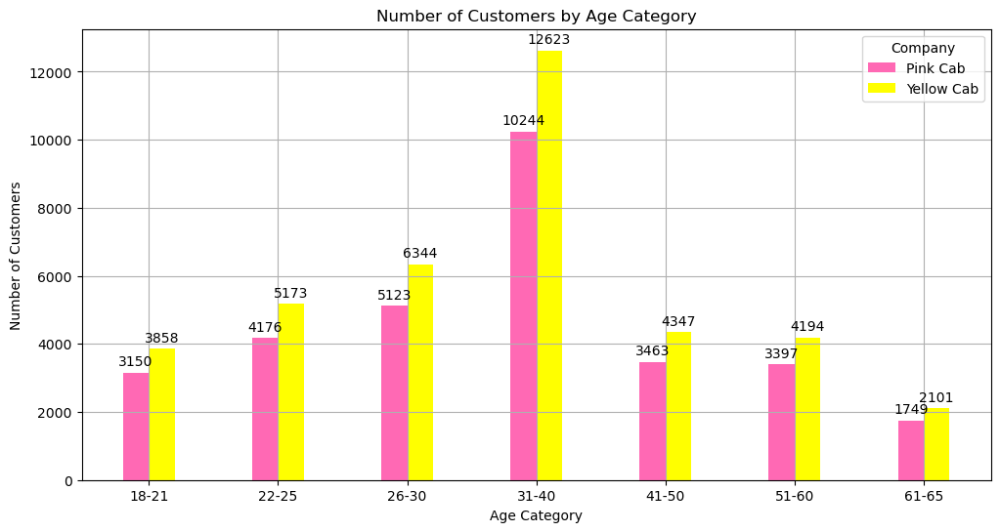

In [65]:
age_customers = master_dataframe.groupby(["Age_Category", "Company"])["Customer ID"].nunique().reset_index()
company_customers_dict = age_customers.pivot(index='Age_Category', columns='Company', values='Customer ID').to_dict()
age_categories = age_customers["Age_Category"].unique().tolist()
companies = age_customers["Company"].unique().tolist()

x = np.arange(len(age_categories))
width = 0.2
custom_colors = ['hotpink', 'yellow']

fig, ax = plt.subplots(figsize=(12, 6))

for i, company in enumerate(companies):
    company_customers = [company_customers_dict[company][age_category] for age_category in age_categories]
    bars = ax.bar(x + i * width, company_customers, width, label=company, color = custom_colors[i])
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f"{height}", xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

ax.set_xlabel('Age Category')
ax.set_ylabel('Number of Customers')
ax.set_title('Number of Customers by Age Category')
ax.set_xticks(x + width * (len(companies) - 1) / 2, age_categories)
ax.legend(title='Company')

plt.grid(True)
plt.show()

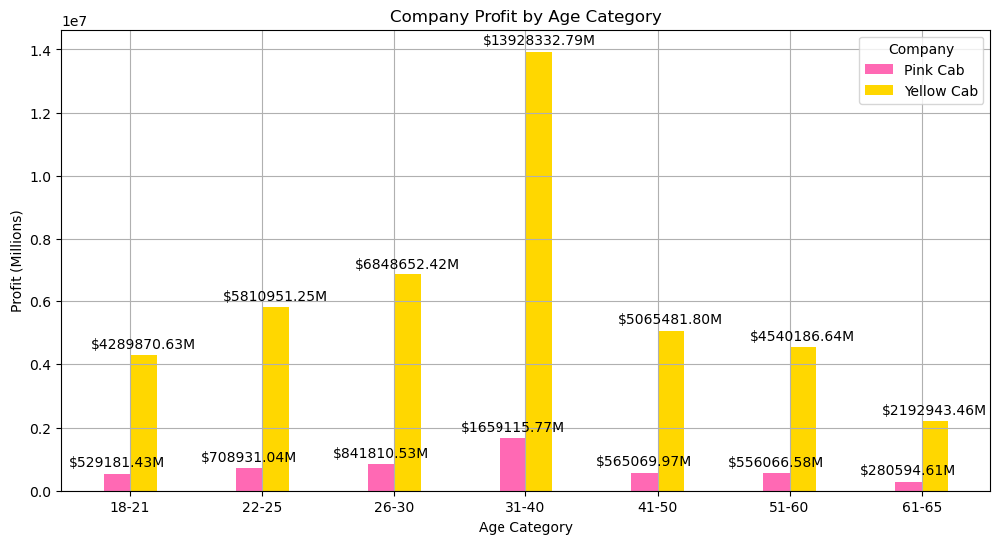

In [66]:
age_profit = master_dataframe.groupby(["Age_Category", "Company"])["Profit"].sum().reset_index()
company_profit_dict = age_profit.pivot(index='Age_Category', columns='Company', values='Profit').to_dict()
age_categories = age_profit["Age_Category"].unique().tolist()
companies = age_profit["Company"].unique().tolist()

x = np.arange(len(age_categories))
width = 0.2
custom_colors = ['hotpink', 'gold']

fig, ax = plt.subplots(figsize=(12, 6))

for i, company in enumerate(companies):
    company_profit = [company_profit_dict[company][age_category] for age_category in age_categories]
    bars = ax.bar(x + i * width, company_profit, width, label=company, color = custom_colors[i])
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f"${height:.2f}M", xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

ax.set_xlabel('Age Category')
ax.set_ylabel('Profit (Millions)')
ax.set_title('Company Profit by Age Category')
ax.set_xticks(x + width * (len(companies) - 1) / 2, age_categories)
ax.legend(title='Company')

plt.grid(True)
plt.show()

### Prices Charged and Cost of Trip per Both Companies

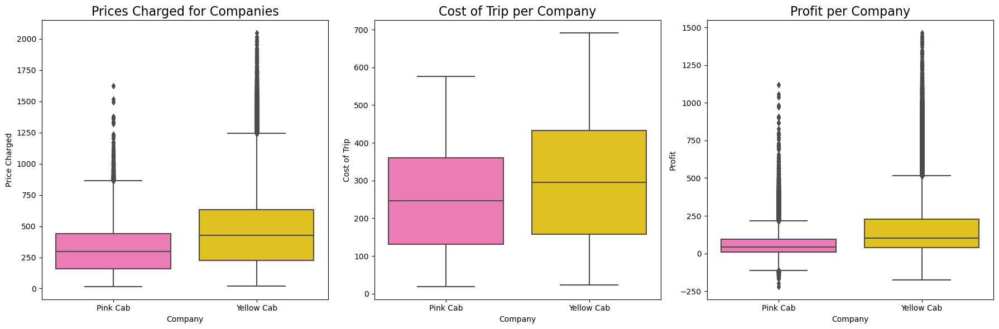

In [67]:
fig, axs = plt.subplots(1, 3, figsize=(18, 6))  # Adjust the figsize as needed

sns.boxplot(data=master_dataframe, x="Company", y="Price Charged", ax=axs[0])
axs[0].set_title("Prices Charged for Companies", fontsize=16)
sns.boxplot(data=master_dataframe, x="Company", y="Cost of Trip", ax=axs[1])
axs[1].set_title("Cost of Trip per Company", fontsize=16)
sns.boxplot(data=master_dataframe, x="Company", y="Profit", ax=axs[2])
axs[2].set_title("Profit per Company", fontsize=16)

plt.tight_layout()
plt.show()

In [68]:
master_dataframe.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 359392 entries, 0 to 359391
Data columns (total 24 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   Transaction ID         359392 non-null  int64         
 1   Date of Travel         359392 non-null  datetime64[ns]
 2   Company                359392 non-null  object        
 3   City                   359392 non-null  object        
 4   KM Travelled           359392 non-null  float64       
 5   Price Charged          359392 non-null  float64       
 6   Cost of Trip           359392 non-null  float64       
 7   Population             359392 non-null  int32         
 8   Users                  359392 non-null  int32         
 9   Customer ID            359392 non-null  int64         
 10  Payment_Mode           359392 non-null  object        
 11  Gender                 359392 non-null  object        
 12  Age                    359392 non-null  int6

### Distributions of Gender, Ride Count and Income for Customers

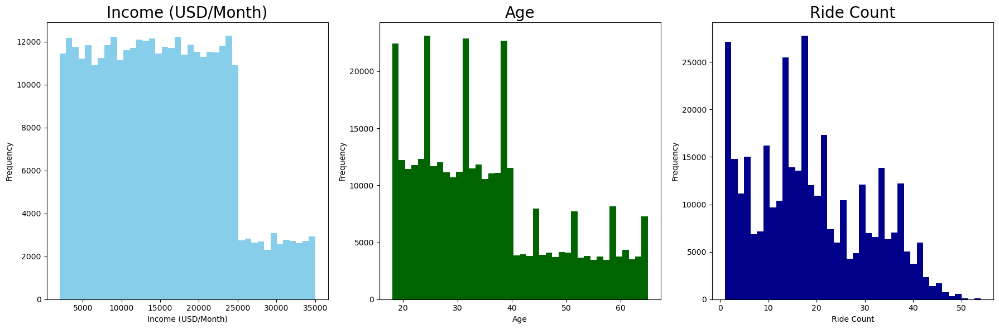

In [69]:
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

axs[0].hist(master_dataframe["Income"], bins=40, color='skyblue')
axs[0].set_title("Income (USD/Month)", fontsize=20)
axs[0].set_ylabel("Frequency")
axs[0].set_xlabel("Income (USD/Month)")

axs[1].hist(master_dataframe["Age"], bins=40, color="darkgreen")
axs[1].set_title("Age", fontsize=20)
axs[1].set_ylabel("Frequency")
axs[1].set_xlabel("Age")

axs[2].hist(master_dataframe["Ride_Count"], bins=40, color="darkblue")
axs[2].set_title("Ride Count", fontsize=20)
axs[2].set_ylabel("Frequency")
axs[2].set_xlabel("Ride Count")

plt.tight_layout()
plt.show()

In [70]:
hsp = master_dataframe.groupby(["City", "Company"])["Profit"].mean().reset_index().sort_values(by="Profit", ascending=False)
hsp1 = master_dataframe.groupby(["City", "Company"])["Profit"].sum().reset_index().sort_values(by="Profit", ascending=False)

In [71]:
hsp

,City,Company,Profit
19,NEW YORK NY,Yellow Cab,307.864252
33,SILICON VALLEY,Yellow Cab,206.788383
9,DALLAS TX,Yellow Cab,195.849415
11,DENVER CO,Yellow Cab,146.853175
21,ORANGE COUNTY,Yellow Cab,143.785355
15,MIAMI FL,Yellow Cab,133.872429
23,PHOENIX AZ,Yellow Cab,131.120407
1,ATLANTA GA,Yellow Cab,128.797723
3,AUSTIN TX,Yellow Cab,125.249582
13,LOS ANGELES CA,Yellow Cab,116.656368


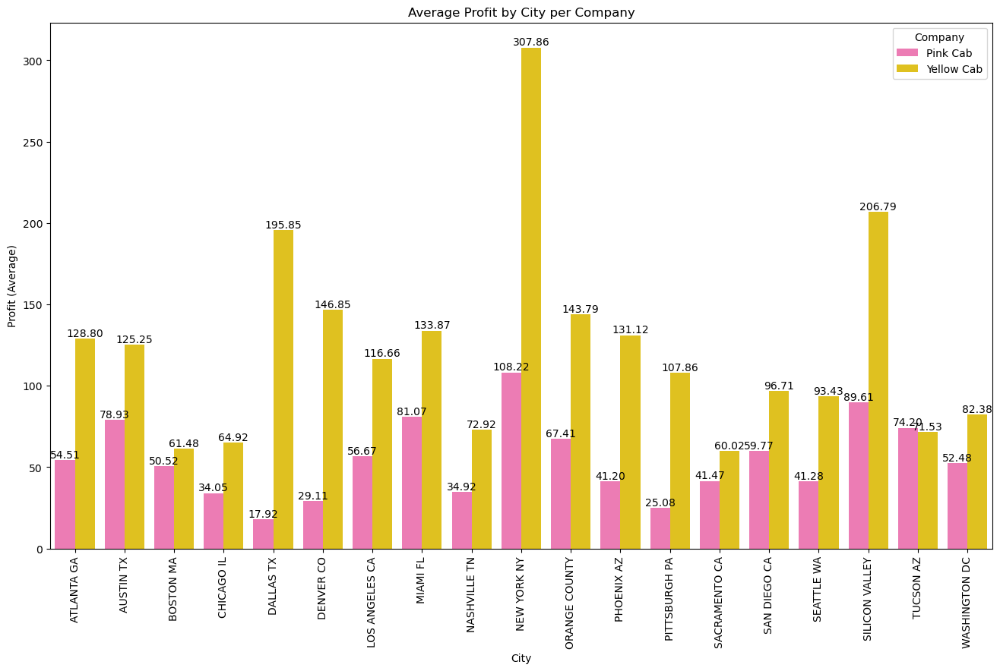

In [72]:
average_profit_data = master_dataframe.groupby(['City', 'Company'])['Profit'].mean().reset_index()

plt.figure(figsize=(16, 9))
custom_colors = {'Yellow Cab': 'gold', 'Pink Cab': 'hotpink'}
sns.set_palette([custom_colors.get(company) for company in average_profit_data['Company']])
ax = sns.barplot(data=average_profit_data, x="City", y="Profit", hue="Company")
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
ax.set_title("Average Profit by City per Company")
ax.set_xlabel("City")
ax.set_ylabel("Profit (Average)")

for p in ax.patches:
    ax.annotate(format(p.get_height(), '.2f'), 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='center', fontsize=10, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.legend(title="Company")

plt.show()

Text(0, 0.5, 'Ride Count')

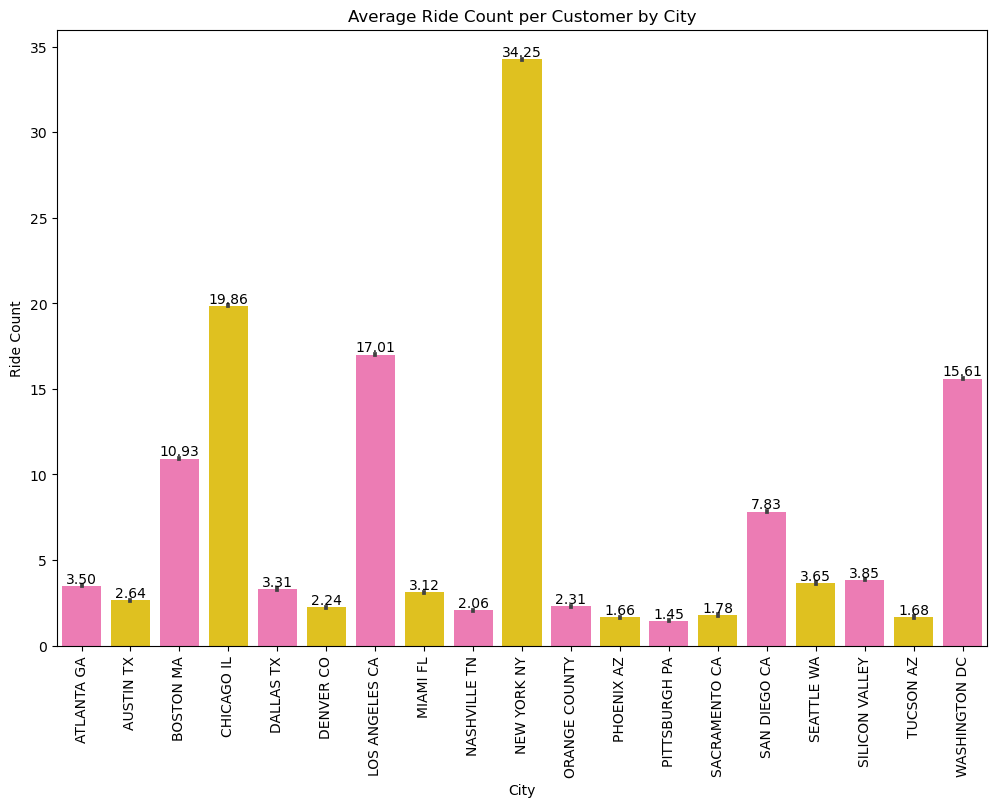

In [73]:
plt.figure(figsize = (12, 8))
# Create the barplot
ax = sns.barplot(data=master_dataframe, x="City", y="Ride_Count")

# Rotate the x-axis tick labels vertically
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

# Adding labels to the bars
for p in ax.patches:
    ax.annotate(format(p.get_height(), ".2f"),
               (p.get_x() + p.get_width() / 2., p.get_height()),
               ha = "center", va = "center", fontsize=10, color="black", xytext=(0, 5),
               textcoords="offset points")

# Set the x-axis label
ax.set_title("Average Ride Count per Customer by City")
ax.set_xlabel("City")
ax.set_ylabel("Ride Count")

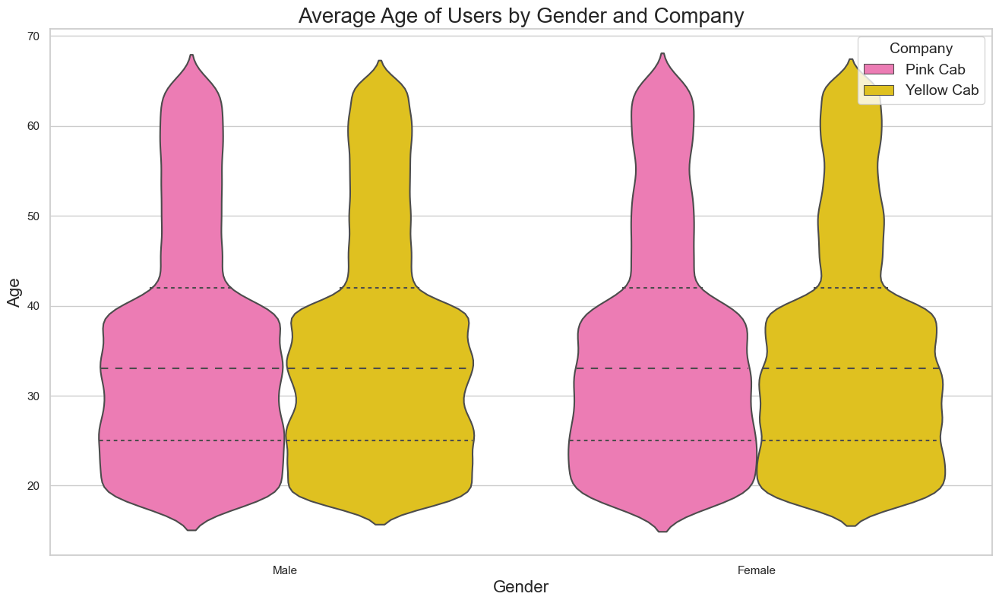

In [74]:
sns.set(style="whitegrid")
plt.figure(figsize=(16, 9))

custom_colors = {'Yellow Cab': 'gold', 'Pink Cab': 'hotpink'}
ax = sns.violinplot(x="Gender", y="Age", hue="Company", data=master_dataframe, palette=custom_colors, inner='quartiles')

plt.xlabel("Gender", fontsize=16)
plt.ylabel("Age", fontsize=16)

legend = plt.legend(title="Company", fontsize=14)
legend.get_title().set_fontsize(14)

plt.title("Average Age of Users by Gender and Company", fontsize=20)
plt.show()

In [75]:
master_dataframe.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 359392 entries, 0 to 359391
Data columns (total 24 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   Transaction ID         359392 non-null  int64         
 1   Date of Travel         359392 non-null  datetime64[ns]
 2   Company                359392 non-null  object        
 3   City                   359392 non-null  object        
 4   KM Travelled           359392 non-null  float64       
 5   Price Charged          359392 non-null  float64       
 6   Cost of Trip           359392 non-null  float64       
 7   Population             359392 non-null  int32         
 8   Users                  359392 non-null  int32         
 9   Customer ID            359392 non-null  int64         
 10  Payment_Mode           359392 non-null  object        
 11  Gender                 359392 non-null  object        
 12  Age                    359392 non-null  int6

### How profits change with respect to income?

C:\Users\rgs88\anaconda3\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


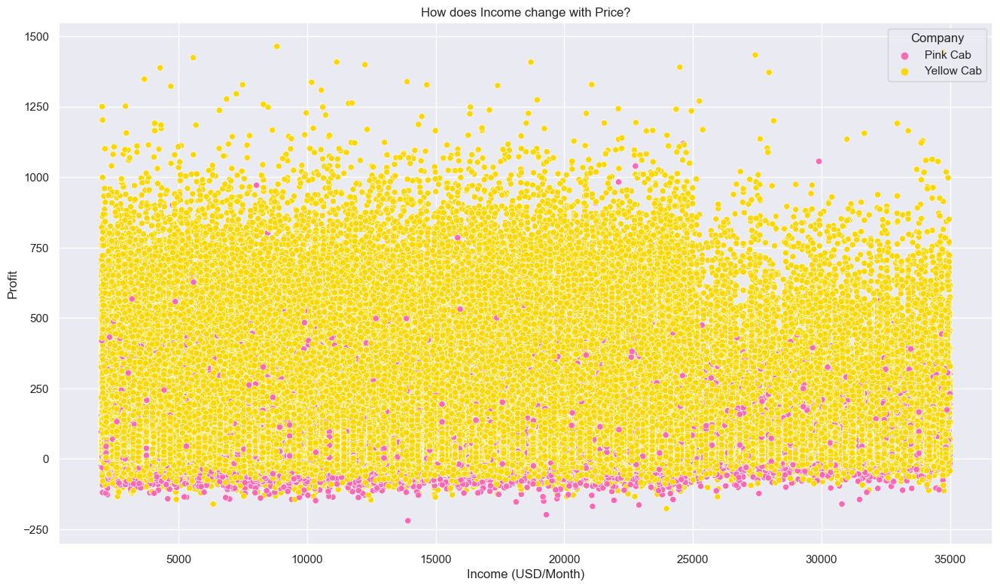

In [76]:
sns.set(style = "darkgrid")
plt.figure(figsize = (16,9))

sns.scatterplot(data = master_dataframe, x = "Income", y = "Profit", hue="Company", palette = custom_colors)
plt.title("How does Income change with Price?")
plt.ylabel("Profit")
plt.xlabel("Income (USD/Month)")
plt.show()

### How prices change with respect to distance?

In [77]:
master_dataframe.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 359392 entries, 0 to 359391
Data columns (total 24 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   Transaction ID         359392 non-null  int64         
 1   Date of Travel         359392 non-null  datetime64[ns]
 2   Company                359392 non-null  object        
 3   City                   359392 non-null  object        
 4   KM Travelled           359392 non-null  float64       
 5   Price Charged          359392 non-null  float64       
 6   Cost of Trip           359392 non-null  float64       
 7   Population             359392 non-null  int32         
 8   Users                  359392 non-null  int32         
 9   Customer ID            359392 non-null  int64         
 10  Payment_Mode           359392 non-null  object        
 11  Gender                 359392 non-null  object        
 12  Age                    359392 non-null  int6

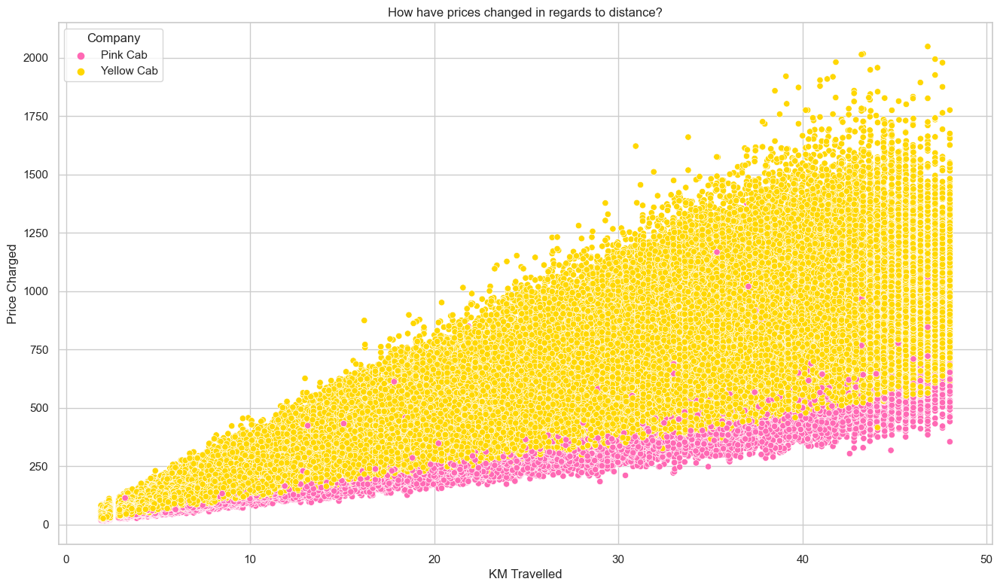

In [78]:
sns.set(style = "whitegrid")
plt.figure(figsize=(16,9))

sns.scatterplot(data = master_dataframe, x="KM Travelled", y="Price Charged", hue="Company", palette = custom_colors)
plt.title("How have prices changed in regards to distance?")
plt.ylabel("Price Charged")
plt.xlabel("KM Travelled")
plt.show()

### How price per KM has changed with respect to time?

In [79]:
master_dataframe["Month"] = master_dataframe["Month"].astype(int)

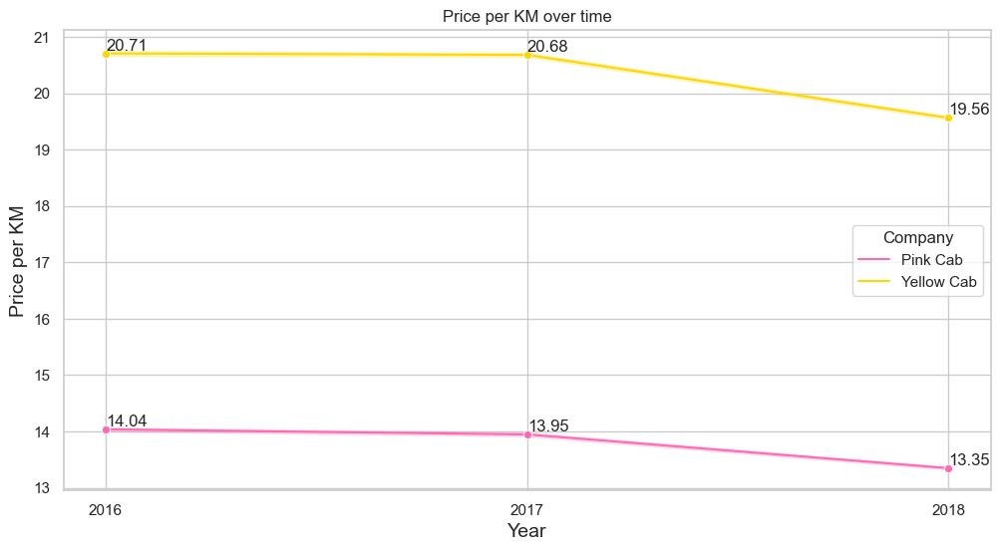

In [80]:
sns.set(style="whitegrid")
plt.figure(figsize=(12, 6))

ax = sns.lineplot(x="Year", y="Price_per_KM", hue="Company", data=master_dataframe, marker='o', palette = custom_colors)
for line in ax.lines:
    x_data, y_data = line.get_data()
    for x, y in zip(x_data, y_data):
        plt.text(x, y, f'{y:.2f}', fontsize=12, ha="left", va="bottom")

plt.xlabel("Year", size=14)
plt.ylabel("Price per KM", size=14)
plt.title("Price per KM over time")
plt.xticks([2016, 2017, 2018])

plt.show()

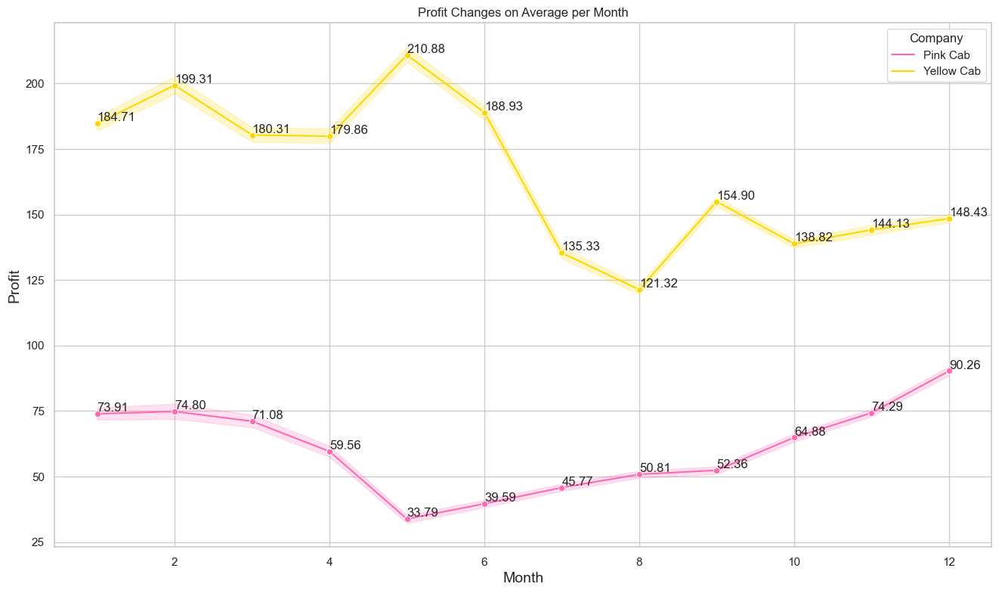

In [81]:
sns.set(style="whitegrid")
plt.figure(figsize=(16, 9))

ax = sns.lineplot(x="Month", y="Profit", hue="Company", data=master_dataframe, marker='o', palette = custom_colors)
for line in ax.lines:
    x_data, y_data = line.get_data()
    for x, y in zip(x_data, y_data):
        plt.text(x, y, f'{y:.2f}', fontsize=12, ha='left', va='bottom')

plt.xlabel("Month", size=14)
plt.ylabel("Profit", size=14)
plt.title("Profit Changes on Average per Month")

plt.legend(title="Company")

plt.show()

In [82]:
master_dataframe

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Population,Users,Customer ID,...,Profit,Price_per_KM,Cost_per_KM,Percentage_Population,Year,Month,Day,Ride_Count,Age_Category,Month_New
0,10000011,2016-01-07,Pink Cab,ATLANTA GA,30.45,370.95,313.6350,814885,24701,29290,...,57.3150,12.182266,10.30,3.031225,2016,1,7,3,26-30,Jan
1,10351127,2018-07-20,Yellow Cab,ATLANTA GA,26.19,598.70,317.4228,814885,24701,29290,...,281.2772,22.859870,12.12,3.031225,2018,7,20,3,26-30,Jul
2,10412921,2018-11-22,Yellow Cab,ATLANTA GA,42.55,792.05,597.4020,814885,24701,29290,...,194.6480,18.614571,14.04,3.031225,2018,11,22,3,26-30,Nov
3,10000012,2016-01-05,Pink Cab,ATLANTA GA,28.62,358.52,334.8540,814885,24701,27703,...,23.6660,12.526904,11.70,3.031225,2016,1,5,4,26-30,Jan
4,10320494,2018-04-20,Yellow Cab,ATLANTA GA,36.38,721.10,467.1192,814885,24701,27703,...,253.9808,19.821330,12.84,3.031225,2018,4,20,4,26-30,Apr
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
359387,10307228,2018-03-02,Yellow Cab,WASHINGTON DC,38.40,668.93,525.3120,418859,127001,51406,...,143.6180,17.420052,13.68,30.320705,2018,3,2,6,26-30,Mar
359388,10319775,2018-04-12,Yellow Cab,WASHINGTON DC,3.57,67.60,44.5536,418859,127001,51406,...,23.0464,18.935574,12.48,30.320705,2018,4,12,6,26-30,Apr
359389,10347676,2018-07-05,Yellow Cab,WASHINGTON DC,23.46,331.97,337.8240,418859,127001,51406,...,-5.8540,14.150469,14.40,30.320705,2018,7,5,6,26-30,Jul
359390,10358624,2018-08-01,Yellow Cab,WASHINGTON DC,27.60,358.23,364.3200,418859,127001,51406,...,-6.0900,12.979348,13.20,30.320705,2018,8,1,6,26-30,Aug


In [83]:
master_dataframe.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 359392 entries, 0 to 359391
Data columns (total 24 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   Transaction ID         359392 non-null  int64         
 1   Date of Travel         359392 non-null  datetime64[ns]
 2   Company                359392 non-null  object        
 3   City                   359392 non-null  object        
 4   KM Travelled           359392 non-null  float64       
 5   Price Charged          359392 non-null  float64       
 6   Cost of Trip           359392 non-null  float64       
 7   Population             359392 non-null  int32         
 8   Users                  359392 non-null  int32         
 9   Customer ID            359392 non-null  int64         
 10  Payment_Mode           359392 non-null  object        
 11  Gender                 359392 non-null  object        
 12  Age                    359392 non-null  int6

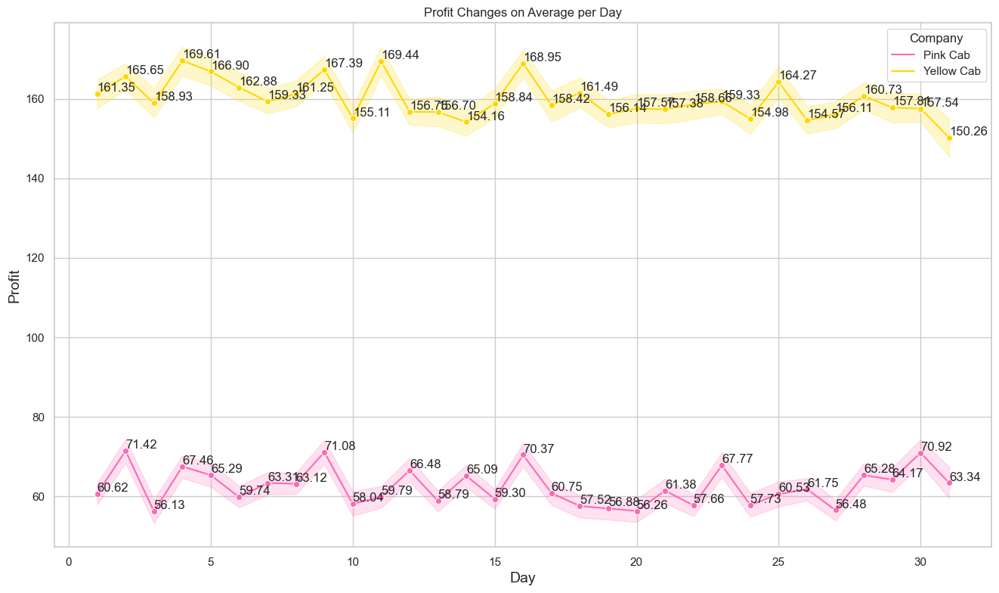

In [84]:
sns.set(style="whitegrid")
plt.figure(figsize=(16, 9))

ax = sns.lineplot(x="Day", y="Profit", hue="Company", data=master_dataframe, marker='o', palette = custom_colors)
for line in ax.lines:
    x_data, y_data = line.get_data()
    for x, y in zip(x_data, y_data):
        plt.text(x, y, f'{y:.2f}', fontsize=12, ha='left', va='bottom')

plt.xlabel("Day", size=14)
plt.ylabel("Profit", size=14)
plt.title("Profit Changes on Average per Day")

plt.legend(title="Company")

plt.show()

## Hypothesis Testing

### Hypothesis 1: Is there any difference in the KM travelled and price per KM?

Hypotheses:
- HO: There is no difference in the KM travelled and the price per KM between the two companies.
- H1: There is a differene in the KM travelled in relation to the price per KM between the two companies.

In [86]:
a = master_dataframe[master_dataframe["Company"]=="Pink Cab"].groupby('KM Travelled')["Price_per_KM"].mean()
b = master_dataframe[master_dataframe["Company"]=="Yellow Cab"].groupby("KM Travelled")["Price_per_KM"].mean()

stat, p_value = stats.ttest_ind(a.values,
                             b.values)

print("p value:%.8f" % p_value)

if p_value < 0.05 :
    print("We accept the alternative hypothesis (H1) and reject the null hypothesis (H0).")
else:
    print("We accept the null hypothesis (H0) and reject the alternative hypothesis (H1).")

p value:0.00000000
We accept the alternative hypothesis (H1) and reject the null hypothesis (H0).


### Hypothesis 2: Is there any difference between income (USD/ Month) and the distance for each journey?

Hypotheses:
- H0: There is no difference between the two cab companies in terms of the income of the customers and the distance per journey.
- H1: There is a difference between the two cab companies in terms of the income of the customers and the distance per journey.

In [87]:
a = master_dataframe[master_dataframe["Company"] == "Pink Cab"].groupby("Income")["KM Travelled"].mean()
b = master_dataframe[master_dataframe["Company"] == "Yellow Cab"].groupby("Income")["KM Travelled"].mean()

stat, p_value = stats.ttest_ind(a.values, b.values)

print("The p-value is: ", p_value)

if p_value < 0.05 :
    print("We accept the alternative hypothesis (H1) and reject the null hypothesis (H0).")
else:
    print("We accept the null hypothesis (H0) and reject the alternative hypothesis (H1).")

The p-value is:  0.6434604598721851
We accept the null hypothesis (H0) and reject the alternative hypothesis (H1).


### Hypothesis 3: Is there any difference between income (USD/ Month) and the number of rides?

Hypotheses:
- H0: There is no difference between the two cab companies in terms of the income of the customers and the number of rides.
- H1: There is a difference between the two cab companies in terms of the income of the customers and the number of rides.

In [88]:
a = master_dataframe[master_dataframe["Company"] == "Pink Cab"].groupby("Income")["Ride_Count"].sum()
b = master_dataframe[master_dataframe["Company"] == "Yellow Cab"].groupby("Income")["Ride_Count"].sum()

ttest, p_value = stats.ttest_ind(a.values, b.values)

print("p value:%.8f" % p_value)

if p_value < 0.05 :
    print("We accept the alternative hypothesis (H1) and reject the null hypothesis (H0).")
else:
    print("We accept the null hypothesis (H0) and reject the alternative hypothesis (H1).")

p value:0.00000000
We accept the alternative hypothesis (H1) and reject the null hypothesis (H0).


### Hypothesis 4: Is there a difference between payment mode and the income (USD/ Month)?

- H0: There is no difference regarding Payment_Mode based on the income of the customer in both cab companies.
- H1: There is a difference regarding Payment_Mode based on the income of the customer in both cab companies.

In [89]:
a = master_dataframe[(master_dataframe["Company"] == "Pink Cab") & (master_dataframe["Payment_Mode"] == "Cash")].groupby("Customer ID").Income.mean()
b = master_dataframe[(master_dataframe["Company"] == "Pink Cab") & (master_dataframe["Payment_Mode"] == "Card")].groupby("Customer ID").Income.mean()

tstat, p_value = stats.ttest_ind(a.values,
                             b.values,
                             equal_var = True)

print("The p value is: ", p_value)

if p_value < 0.05:    
    print("We will reject the null hypothesis and accept the alternative hypothesis.")
else:
    print("We will accept the null hypothesis and reject the alternative hypothesis.")

The p value is:  0.5251267293580919
We will accept the null hypothesis and reject the alternative hypothesis.


In [90]:
a = master_dataframe[(master_dataframe["Company"] == "Yellow Cab") & (master_dataframe["Payment_Mode"] == "Cash")].groupby("Customer ID").Income.mean()
b = master_dataframe[(master_dataframe["Company"] == "Yellow Cab") & (master_dataframe["Payment_Mode"] == "Card")].groupby("Customer ID").Income.mean()

tstat, p_value = stats.ttest_ind(a.values, b.values, equal_var = True)

print("The p value is: ", p_value)

if p_value < 0.05:
    print("We will reject the null hyptohesis and accept the alternative hypothesis.")
else:
    print("We will accept the null hypothesis and reject the alternative hypothesis.")

The p value is:  0.4273760984910555
We will accept the null hypothesis and reject the alternative hypothesis.


### Hypothesis 5: Is there any difference in the Profit regarding the Age?

Hypotheses:
- H0: There is no difference regarding Payment_Mode in both cab companies.
- H1: There is a difference regarding Payment_Mode in both cab companies.

#### Pink Cab

In [91]:
pink_cab_data = master_dataframe[master_dataframe["Company"] == "Pink Cab"]
age_18_21_data = pink_cab_data[pink_cab_data["Age_Category"] == "18-21"]["Profit"]
age_22_25_data = pink_cab_data[pink_cab_data["Age_Category"] == "22-25"]["Profit"]
age_26_30_data = pink_cab_data[pink_cab_data["Age_Category"] == "26-30"]["Profit"]
age_31_40_data = pink_cab_data[pink_cab_data["Age_Category"] == "31-40"]["Profit"]
age_41_50_data = pink_cab_data[pink_cab_data["Age_Category"] == "41-50"]["Profit"]
age_51_60_data = pink_cab_data[pink_cab_data["Age_Category"] == "51-60"]["Profit"]
age_61_65_data = pink_cab_data[pink_cab_data["Age_Category"] == "61-65"]["Profit"]

stat, p_value_levene = stats.levene(
    age_18_21_data, age_22_25_data, age_26_30_data, 
    age_31_40_data, age_41_50_data, age_51_60_data, age_61_65_data
)

print("p value:%.4f" % p_value_levene)

if p_value_levene < 0.05:
    print("Reject null hypothesis >> The variances of the samples are different.")
else:
    print("Fail to reject null hypothesis >> The variances of the samples are the same.")
    

p value:0.3732
Fail to reject null hypothesis >> The variances of the samples are the same.


#### Yellow Cab

In [92]:
yellow_cab_data = master_dataframe[master_dataframe["Company"] == "Yellow Cab"]
age_18_21_data = yellow_cab_data[yellow_cab_data["Age_Category"] == "18-21"]["Profit"]
age_22_25_data = yellow_cab_data[yellow_cab_data["Age_Category"] == "22-25"]["Profit"]
age_26_30_data = yellow_cab_data[yellow_cab_data["Age_Category"] == "26-30"]["Profit"]
age_31_40_data = yellow_cab_data[yellow_cab_data["Age_Category"] == "31-40"]["Profit"]
age_41_50_data = yellow_cab_data[yellow_cab_data["Age_Category"] == "41-50"]["Profit"]
age_51_60_data = yellow_cab_data[yellow_cab_data["Age_Category"] == "51-60"]["Profit"]
age_61_65_data = yellow_cab_data[yellow_cab_data["Age_Category"] == "61-65"]["Profit"]

stat, p_value_levene = stats.levene(
    age_18_21_data, age_22_25_data, age_26_30_data, 
    age_31_40_data, age_41_50_data, age_51_60_data, age_61_65_data
)

print("p value:%.4f" % p_value_levene)

if p_value_levene < 0.05:
    print("Reject null hypothesis >> The variances of the samples are different.")
else:
    print("Fail to reject null hypothesis >> The variances of the samples are the same.")

p value:0.0000
Reject null hypothesis >> The variances of the samples are different.


### Hypothesis 6: Is there any difference in Profit regarding Gender?

Hypotheses:
- H0: There is no difference between the companies regarding profit based on the gender.
- H1: There is a difference between the companies regarding profit based on the gender.

In [93]:
a = master_dataframe[(master_dataframe["Company"] == "Pink Cab") & (master_dataframe["Gender"] == "Male")].groupby("Transaction ID").Profit.mean()
b = master_dataframe[(master_dataframe["Company"] == "Pink Cab") & (master_dataframe["Gender"] == "Female")].groupby("Transaction ID").Profit.mean()

tstat, p_value = stats.ttest_ind(a.values, b.values, equal_var = True)

print("P Value is ", p_value)

if (p_value < 0.05):
    print("We reject the null hypothesis (H0) and accept the alternative hypothesis (H1).")
else:
    print("We accept the null hypothesis (H0) and reject the null hypothesis (H0).")


P Value is  0.11515305900425798
We accept the null hypothesis (H0) and reject the null hypothesis (H0).


In [94]:
a = master_dataframe[(master_dataframe["Company"] == "Yellow Cab") & (master_dataframe["Gender"] == "Male")].groupby("Transaction ID").Profit.mean()
b = master_dataframe[(master_dataframe["Company"] == "Yellow Cab") & (master_dataframe["Gender"] == "Female")].groupby("Transaction ID").Profit.mean()

tstat, p_value = stats.ttest_ind(a.values, b.values, equal_var = True)

print("P Value is ", p_value)

if (p_value < 0.05):
    print("We reject the null hypothesis (H0) and accept the alternative hypothesis (H1).")
else:
    print("We accept the null hypothesis (H0) and reject the null hypothesis (H0).")

P Value is  6.060473042494056e-25
We reject the null hypothesis (H0) and accept the alternative hypothesis (H1).
